<h1 style = "color : Blue"> Credit EDA Case Study </h1>

<h3 style = "color : Orange"> Problem Statement </h3>


This case study aims to identify patterns which indicate if a client has difficulty paying their installments which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc. This will ensure that the consumers capable of repaying the loan are not rejected. Identification of such applicants using EDA is the aim of this case study. 

In other words, the company wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import warnings
warnings.filterwarnings(action = 'ignore')

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)


# Data Set 1: Application Data

In [2]:
# Loading the Application data as "app"

app = pd.read_csv('application_data.csv')

In [3]:
app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [4]:
app.shape

(307511, 122)

In [5]:
app.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Non-Null Count   Dtype  
---   ------                        --------------   -----  
 0    SK_ID_CURR                    307511 non-null  int64  
 1    TARGET                        307511 non-null  int64  
 2    NAME_CONTRACT_TYPE            307511 non-null  object 
 3    CODE_GENDER                   307511 non-null  object 
 4    FLAG_OWN_CAR                  307511 non-null  object 
 5    FLAG_OWN_REALTY               307511 non-null  object 
 6    CNT_CHILDREN                  307511 non-null  int64  
 7    AMT_INCOME_TOTAL              307511 non-null  float64
 8    AMT_CREDIT                    307511 non-null  float64
 9    AMT_ANNUITY                   307499 non-null  float64
 10   AMT_GOODS_PRICE               307233 non-null  float64
 11   NAME_TYPE_SUITE               306219 non-null  object 
 12   NAME_INCOME_TYPE            

In [6]:
app.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.97

<h1 style = "color : Blue"> Data Cleaning </h1>

#### Counding the null values in each column using isnull() function

In [7]:
# Counding the null values in each column
app.isnull().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

#### Finding the percentage of null values in each column

In [8]:

(app.isnull().sum() / app.shape[0] * 100).sort_values(ascending = False)

# There are lots of columns whose null value is greater than 45%

COMMONAREA_MEDI                 69.872297
COMMONAREA_AVG                  69.872297
COMMONAREA_MODE                 69.872297
NONLIVINGAPARTMENTS_MODE        69.432963
NONLIVINGAPARTMENTS_AVG         69.432963
NONLIVINGAPARTMENTS_MEDI        69.432963
FONDKAPREMONT_MODE              68.386172
LIVINGAPARTMENTS_MODE           68.354953
LIVINGAPARTMENTS_AVG            68.354953
LIVINGAPARTMENTS_MEDI           68.354953
FLOORSMIN_AVG                   67.848630
FLOORSMIN_MODE                  67.848630
FLOORSMIN_MEDI                  67.848630
YEARS_BUILD_MEDI                66.497784
YEARS_BUILD_MODE                66.497784
YEARS_BUILD_AVG                 66.497784
OWN_CAR_AGE                     65.990810
LANDAREA_MEDI                   59.376738
LANDAREA_MODE                   59.376738
LANDAREA_AVG                    59.376738
BASEMENTAREA_MEDI               58.515956
BASEMENTAREA_AVG                58.515956
BASEMENTAREA_MODE               58.515956
EXT_SOURCE_1                    56

#### Creating a data frame named 'null_col' containing the columns with > 45% null values in  'app' data

In [9]:
null_col = app.isnull().sum() / app.shape[0] * 100
null_col = null_col[null_col.values > 45]
null_col.head()

OWN_CAR_AGE                    65.990810
EXT_SOURCE_1                   56.381073
APARTMENTS_AVG                 50.749729
BASEMENTAREA_AVG               58.515956
YEARS_BEGINEXPLUATATION_AVG    48.781019
dtype: float64

#### number of columns with percentage of null values > 45%

In [10]:

null_col.shape

(49,)

#### droping the columns containg more than 45% null values

In [11]:

app.drop(null_col.index, axis = 1, inplace = True)

#### After dropping the columns, the shape of Data Frame "app"

In [12]:
app.shape

(307511, 73)

#### List of columns having null values

In [13]:
print(len(app.columns[app.isnull().any()].tolist()))
app.columns[app.isnull().any()].tolist()

18


['AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'OCCUPATION_TYPE',
 'CNT_FAM_MEMBERS',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

In [14]:
(app.isnull().sum() / app.shape[0]*100).sort_values(ascending = False).head(18)

OCCUPATION_TYPE               31.345545
EXT_SOURCE_3                  19.825307
AMT_REQ_CREDIT_BUREAU_YEAR    13.501631
AMT_REQ_CREDIT_BUREAU_QRT     13.501631
AMT_REQ_CREDIT_BUREAU_MON     13.501631
AMT_REQ_CREDIT_BUREAU_WEEK    13.501631
AMT_REQ_CREDIT_BUREAU_DAY     13.501631
AMT_REQ_CREDIT_BUREAU_HOUR    13.501631
NAME_TYPE_SUITE                0.420148
OBS_30_CNT_SOCIAL_CIRCLE       0.332021
DEF_30_CNT_SOCIAL_CIRCLE       0.332021
OBS_60_CNT_SOCIAL_CIRCLE       0.332021
DEF_60_CNT_SOCIAL_CIRCLE       0.332021
EXT_SOURCE_2                   0.214626
AMT_GOODS_PRICE                0.090403
AMT_ANNUITY                    0.003902
CNT_FAM_MEMBERS                0.000650
DAYS_LAST_PHONE_CHANGE         0.000325
dtype: float64

Now we have 18 columns having null values. In which only two columns have null values more than 15%, remaining columns have null value less than **15%** .

<h1 style = "color : Blue"> Treating the Missing Values </h1>

#### Analysing the missing values in "OCCUPATION_TYPE" column

Here the 'OCCUPATION_TYPE' column contains the detail of client's occupation. It has 18 unique values. 31% of the occupation of the clients is missing, that is the occupation of 96391(closely 1L) clients are missing. Dropping these columns is not a good idea. Since it's a categorical variable imputing it with mode.

In [15]:
app.OCCUPATION_TYPE.head()

0      Laborers
1    Core staff
2      Laborers
3      Laborers
4    Core staff
Name: OCCUPATION_TYPE, dtype: object

In [16]:
app.OCCUPATION_TYPE.describe()

count       211120
unique          18
top       Laborers
freq         55186
Name: OCCUPATION_TYPE, dtype: object

In [17]:
app.OCCUPATION_TYPE.value_counts()

Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

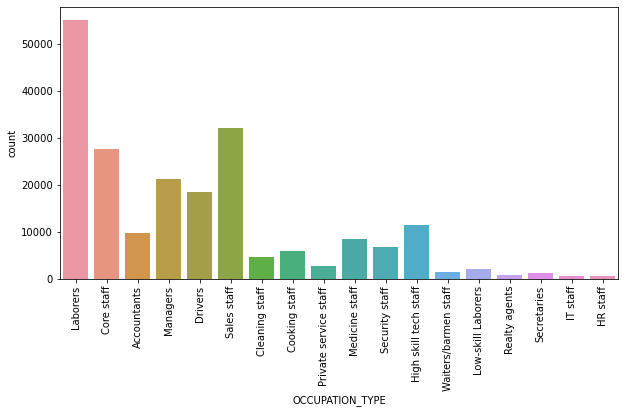

In [18]:
plt.figure(figsize = [10,5])
sns.countplot(app.OCCUPATION_TYPE)
plt.xticks(rotation = 90)
plt.show()

In [19]:
app.OCCUPATION_TYPE.isnull().sum()

96391

In [20]:
app.OCCUPATION_TYPE.fillna('Laborers', inplace = True)

In [21]:
app.OCCUPATION_TYPE.isnull().sum()

0

#### Analysing the missing values in "EXT_SOURCE_3" column

Here percentage of missing value in **"EXT_SOURCE_3"** column is 20%.
Dropping both the columns "EXT_SOURCE_3" and "EXT_SOURCE_2" since its not significant for the analysis

In [22]:
app.EXT_SOURCE_3.describe()

count    246546.000000
mean          0.510853
std           0.194844
min           0.000527
25%           0.370650
50%           0.535276
75%           0.669057
max           0.896010
Name: EXT_SOURCE_3, dtype: float64

In [23]:
# percentage of missing value
round(app.EXT_SOURCE_3.isnull().sum() / app.shape[0]*100)

20

In [24]:
app.drop('EXT_SOURCE_3', inplace = True, axis = 1)
app.drop('EXT_SOURCE_2', inplace = True, axis = 1)

####  Analysing the missing values in "AMT_ANNUITY" column

In "AMT_ANNUITY" column only 12 records are missing hence droping this record is the better option.

In [25]:
# null value counts in "AMT_ANNUITY" column
app.AMT_ANNUITY.isnull().sum()

12

In [26]:
app.AMT_ANNUITY.describe()

count    307499.000000
mean      27108.573909
std       14493.737315
min        1615.500000
25%       16524.000000
50%       24903.000000
75%       34596.000000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

In [27]:
# droping the rows where "AMT_ANNUITY" is null
app.dropna(axis=0, inplace = True, subset = ['AMT_ANNUITY'])

In [28]:
app.AMT_ANNUITY.isnull().sum()

0

#### Dropping "DAYS_LAST_PHONE_CHANGE" column

In [29]:
app.DAYS_LAST_PHONE_CHANGE.isnull().sum()

1

In [30]:
# droping the row having null value
app.dropna(axis = 0, inplace = True, subset = ['DAYS_LAST_PHONE_CHANGE'])

#### Droppin  "CNT_FAM_MEMBERS" column

In [31]:
app.CNT_FAM_MEMBERS.isnull().sum()

2

In [32]:
app.dropna(axis = 0, inplace = True, subset = ['CNT_FAM_MEMBERS'])

<h4 style = "color : Red"> Handling the outliers in "AMT_GOODS_PRICE" column </h4>

For consumer loans it is the price of the goods for which the loan is given. Here the maximum good price is 4050000 and minimum is 40500.0. In this data 99% values are under 18L and only 1% of values are above 18L, it is possinble for price of goods to have such a huge value. Here keeping the null value colums as null value is better.

In [33]:
app.AMT_GOODS_PRICE.isnull().sum()

276

In [34]:
app.AMT_GOODS_PRICE.describe()

count    3.072200e+05
mean     5.383983e+05
std      3.694486e+05
min      4.050000e+04
25%      2.385000e+05
50%      4.500000e+05
75%      6.795000e+05
max      4.050000e+06
Name: AMT_GOODS_PRICE, dtype: float64

In [35]:
print(app.AMT_GOODS_PRICE.max())
print(app.AMT_GOODS_PRICE.min())

4050000.0
40500.0


In [36]:
px.box(app.AMT_GOODS_PRICE, title = 'Distribution of AMT_GOODS_PRICE')

In [37]:
app.AMT_GOODS_PRICE.quantile([0.25,0.30,0.50,0.75, 0.80, 0.85, 0.90, 0.95, 0.97, 0.98, 0.99,1])

0.25     238500.0
0.30     270000.0
0.50     450000.0
0.75     679500.0
0.80     814500.0
0.85     900000.0
0.90    1093500.0
0.95    1305000.0
0.97    1354500.0
0.98    1575000.0
0.99    1800000.0
1.00    4050000.0
Name: AMT_GOODS_PRICE, dtype: float64

#### Treating of columns starting with "AMT_REQ_CREDIT_BUREAU" 

The columns starting with "AMT_REQ_CREDIT_BUREAU" indicates the Number of inquiries to Credit Bureau about the client one week before, day before, hour before ect. Dropping the columns 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_YEAR' since its nor relevant for our anlysis, and keeping the columns 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_ORT'.

Imputing the missing values with mode of the respective columns.

In [38]:
# drpping 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_YEAR' 
app.drop(['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_YEAR'], axis = True, inplace = True)

In [39]:
print(app.AMT_REQ_CREDIT_BUREAU_DAY.mode()[0])
print(app.AMT_REQ_CREDIT_BUREAU_MON.mode()[0])
print(app.AMT_REQ_CREDIT_BUREAU_QRT.mode()[0])

0.0
0.0
0.0


In [40]:

app.AMT_REQ_CREDIT_BUREAU_DAY.fillna(app.AMT_REQ_CREDIT_BUREAU_DAY.mode()[0], inplace = True)
app.AMT_REQ_CREDIT_BUREAU_MON.fillna(app.AMT_REQ_CREDIT_BUREAU_MON.mode()[0], inplace = True)
app.AMT_REQ_CREDIT_BUREAU_QRT.fillna(app.AMT_REQ_CREDIT_BUREAU_QRT.mode()[0], inplace = True)

In [41]:
app.columns[app.isnull().any()].tolist()

['AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE']

<h1 style = "color : Blue"> Checking Data type errors in Columns </h1>


In [42]:
app.shape

(307496, 68)

In [43]:
app.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT
count,307496.000000,307496.000000,307496.000000,3.074960e+05,3.074960e+05,307496.000000,3.072200e+05,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.0,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,306475.000000,306475.000000,306475.000000,306475.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000
mean,278182.749285,0.080733,0.417072,1.687963e+05,5.990281e+05,27108.549241,5.383983e+05,0.020868,-16037.100707,63818.252094,-4986.126746,-2994.218507,1.0,0.819881,0.199362,0.998133,0.281057,0.056719,2.152682,2.052479,2.031535,12.063328,0.015142,0.050755,0.040644,0.078167,0.230445,0.179544,1.422292,0.143428,1.405338,0.100054,-962.863400,0.000042,0.710032,0.000081,0.015106,0.088060,0.000189,0.081370,0.003896,0.000023,0.003912,0.000007,0.003525,0.002937,0.001210,0.009929,0.000267,0.008127,0.000595,0.000507,0.000335,0.006055,0.231284,0.229632
std,102790.172484,0.272425,0.722133,2.371280e+05,4.024942e+05,14493.802393,3.694486e+05,0.013831,4363.992221,141278.466175,3522.867752,1509.451425,0.0,0.384288,0.399521,0.043165,0.449516,0.231306,0.910693,0.509032,0.502735,3.265852,0.122116,0.219498,0.197465,0.268434,0.421119,0.383808,2.401032,0.446708,2.379846,0.362299,826.811646,0.006502,0.453748,0.009016,0.121974,0.283382,0.013733,0.273403,0.062296,0.004771,0.062426,0.002550,0.059269,0.054111,0.034761,0.099147,0.016328,0.089783,0.024388,0.022518,0.018299,0.103040,0.856820,0.744072
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,-24672.000000,-7197.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-4292.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189150.750000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,-7479.000000,-4299.000000,1.0,1.000000,0.000000,1.000000,0.000000,0.000000,2.000000,2.000000,2.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1570.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278204.

#### 1) "ORGANIZATION_TYPE" column 
Replacing "XNA" with  null value

In [44]:
app.ORGANIZATION_TYPE.value_counts().head()

Business Entity Type 3    67989
XNA                       55374
Self-employed             38409
Other                     16681
Medicine                  11192
Name: ORGANIZATION_TYPE, dtype: int64

In [45]:
# replacing "XNA" with Null value
app.ORGANIZATION_TYPE.replace("XNA", np.NaN, inplace = True)

#### 2) Checking the columns starting with "DAYS"

Applying abs() function on these columns to convert the negative values to positive values since it indicates the number of days and it can't be a negative value

In [46]:
print(app.DAYS_BIRTH.unique())
print(app.DAYS_EMPLOYED.unique())
print(app.DAYS_REGISTRATION.unique())
print(app.DAYS_ID_PUBLISH.unique())
print(app.DAYS_LAST_PHONE_CHANGE.unique())

[ -9461 -16765 -19046 ...  -7951  -7857 -25061]
[  -637  -1188   -225 ... -12971 -11084  -8694]
[ -3648.  -1186.  -4260. ... -16396. -14558. -14798.]
[-2120  -291 -2531 ... -6194 -5854 -6211]
[-1134.  -828.  -815. ... -3988. -3899. -3538.]


In [47]:
# Applying abs() function on the columns

days_col = [c for c in app.columns if c.startswith('DAYS')]
app[days_col] = abs(app[days_col])

#### 3) Checking "DAYS_BIRTH" column
Converting into age by dividing the values by 365 and creating a new column named "Age" to store the values. And finally Dropping the column "DAYS_BIRTH" since the it's in number of days.

In [48]:
app.DAYS_BIRTH.unique()

array([ 9461, 16765, 19046, ...,  7951,  7857, 25061], dtype=int64)

In [49]:
# Creating the Age colum and changing its data type into integer since Ages are in integer format
app['Age']= app.DAYS_BIRTH / 365
app['Age'] = app['Age'].astype(int)
app['Age'].describe()

count    307496.000000
mean         43.436253
std          11.954601
min          20.000000
25%          34.000000
50%          43.000000
75%          53.000000
max          69.000000
Name: Age, dtype: float64

In [50]:
# We can see that the age variable varies between 20 and 69, therefore creating a bin of age
app['AGE_GROUP']= pd.cut(app.Age,bins=np.arange(20,71,5))
app.AGE_GROUP.value_counts()

(35, 40]    43679
(40, 45]    39995
(30, 35]    39433
(25, 30]    36486
(50, 55]    35096
(45, 50]    34402
(55, 60]    32721
(60, 65]    24359
(20, 25]    16315
(65, 70]     5009
Name: AGE_GROUP, dtype: int64

In [51]:
# dropping the "DAYS_BIRTH" column
app.drop('DAYS_BIRTH', axis = 1, inplace = True)

#### 4) Checking "CODE_GENDER" column

In [52]:
app.CODE_GENDER.value_counts()

F      202439
M      105053
XNA         4
Name: CODE_GENDER, dtype: int64

In [53]:
# Replacing "XNA" with "F"
app.CODE_GENDER.replace('XNA', "F", inplace = True)

In [54]:
# Replacing "F" with "Female" and "M" with "Male"
app.CODE_GENDER.replace("F", "Female", inplace = True)
app.CODE_GENDER.replace("M", "Male", inplace = True)

In [55]:
app.CODE_GENDER.value_counts()

Female    202443
Male      105053
Name: CODE_GENDER, dtype: int64

#### Dropping Columns starts with "FLAG_DOCUMENT"

In [56]:
for i in app.columns:
    if i.startswith('FLAG_DOCUMENT'):
        app.drop(i, inplace = True, axis = 1)

#### "FLAG"


Dropping the columns 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE' and keeping the record of 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'FLAG_EMAIL' since these are relevant for our analysis.
 

In [57]:
app.drop(['FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE'], axis = 1, inplace = True)

In [58]:
for i in app.columns:
    if i.startswith('FLAG'):
        print(i)

FLAG_OWN_CAR
FLAG_OWN_REALTY
FLAG_EMAIL


<h4 style = "color : Red"> Handling the outliers in  "CNT_CHILDREN" column </h4>


Removing the outliers from the data set, here keeping the record of people having less than 8 children


In [59]:
app.CNT_CHILDREN.value_counts()

0     215356
1      61119
2      26749
3       3717
4        429
5         84
6         21
7          7
14         3
8          2
9          2
10         2
12         2
19         2
11         1
Name: CNT_CHILDREN, dtype: int64

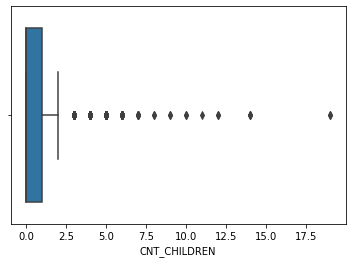

In [60]:
sns.boxplot(app.CNT_CHILDREN)
plt.show()

In [61]:
# removing the outliers from the data, that is removing the record of people with more than 7 children

app = app[app.CNT_CHILDREN <= 7]

#### Creating variables for percentage of social circle who defaulted

In [62]:
### Getting the percentage of social circle who defaulted
app['SOCIAL_CIRCLE_30_DAYS_DEF_PERC'] = app['DEF_30_CNT_SOCIAL_CIRCLE'] / app['OBS_30_CNT_SOCIAL_CIRCLE']
app['SOCIAL_CIRCLE_60_DAYS_DEF_PERC'] = app['DEF_60_CNT_SOCIAL_CIRCLE'] / app['OBS_60_CNT_SOCIAL_CIRCLE']

#### Creating A new categorical variable based on income total

In [63]:

app['INCOME_GROUP'] = pd.qcut(app.AMT_INCOME_TOTAL, q=[0,0.1,0.3,0.6,0.8,1], labels=['VeryLow','Low','Medium','High','VeryHigh'])

#### Creating a new column contain the ratio of credit to income

In [64]:
app['CREDIT_INCOME_RATIO'] = round((app.AMT_CREDIT / app.AMT_INCOME_TOTAL))

<h4 style = "color : Red"> Imbalancing in Target variable </h4>

Here the percentage of defaulted people is 8% while 92% the people didn't default

In [65]:
app.TARGET.describe()

count    307482.000000
mean          0.080727
std           0.272415
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: TARGET, dtype: float64

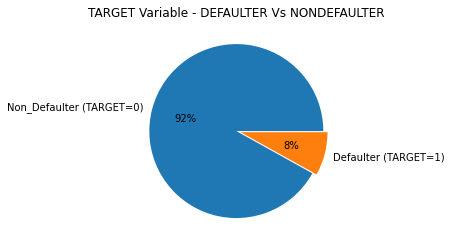

In [66]:

plt.pie(app.TARGET.value_counts(normalize=True)*100,labels=['Non_Defaulter (TARGET=0)','Defaulter (TARGET=1)'],explode=(0,0.05),autopct='%1.f%%')
plt.title('TARGET Variable - DEFAULTER Vs NONDEFAULTER')
plt.show()

#### Removing the data which are not relevant for the analysis

In [67]:
app.drop(['NAME_TYPE_SUITE', 'REGION_POPULATION_RELATIVE','DAYS_ID_PUBLISH', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'WEEKDAY_APPR_PROCESS_START','HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION','REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION','REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY','LIVE_CITY_NOT_WORK_CITY', 'DAYS_LAST_PHONE_CHANGE', 'Age'], inplace = True, axis = 1)

#### Creating bins for income amount

<h3 style = "color : Green"> Final Data Frame </h3>


In [68]:
app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,DAYS_REGISTRATION,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,ORGANIZATION_TYPE,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AGE_GROUP,SOCIAL_CIRCLE_30_DAYS_DEF_PERC,SOCIAL_CIRCLE_60_DAYS_DEF_PERC,INCOME_GROUP,CREDIT_INCOME_RATIO
0,100002,1,Cash loans,Male,N,Y,0,202500.0,406597.5,24700.5,351000.0,Working,Secondary / secondary special,Single / not married,House / apartment,637,3648.0,0,Laborers,1.0,2,2,Business Entity Type 3,0.0,0.0,0.0,"(20, 25]",1.0,1.0,High,2.0
1,100003,0,Cash loans,Female,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,1188,1186.0,0,Core staff,2.0,1,1,School,0.0,0.0,0.0,"(40, 45]",0.0,0.0,VeryHigh,5.0
2,100004,0,Revolving loans,Male,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Working,Secondary / secondary special,Single / not married,House / apartment,225,4260.0,0,Laborers,1.0,2,2,Government,0.0,0.0,0.0,"(50, 55]",NaN,NaN,VeryLow,2.0
3,100006,0,Cash loans,Female,N,Y,0,135000.0,312682.5,29686.5,297000.0,Working,Secondary / secondary special,Civil marriage,House / apartment,3039,9833.0,0,Laborers,2.0,2,2,Business Entity Type 3,0.0,0.0,0.0,"(50, 55]",0.0,0.0,Medium,2.0
4,100007,0,Cash loans,Male,N,Y,0,121500.0,513000.0,21865.5,513000.0,Working,Secondary / secondary special,Single / not married,House / apartment,3038,4311.0,0,Core staff,1.0,2,2,Religion,0.0,0.0,0.0,"(50, 55]",NaN,NaN,Medium,4.0


In [69]:
app.shape

(307482, 31)

In [70]:
app.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_INCOME_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'FLAG_EMAIL', 'OCCUPATION_TYPE',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'ORGANIZATION_TYPE',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AGE_GROUP',
       'SOCIAL_CIRCLE_30_DAYS_DEF_PERC', 'SOCIAL_CIRCLE_60_DAYS_DEF_PERC',
       'INCOME_GROUP', 'CREDIT_INCOME_RATIO'],
      dtype='object')

## Creating Two Data frame for Defaulters and Non_Dafaulters for further analysis

In [71]:
default = app[app.TARGET == 1]
n_default = app[app.TARGET == 0]

In [72]:
default.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,DAYS_REGISTRATION,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,ORGANIZATION_TYPE,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AGE_GROUP,SOCIAL_CIRCLE_30_DAYS_DEF_PERC,SOCIAL_CIRCLE_60_DAYS_DEF_PERC,INCOME_GROUP,CREDIT_INCOME_RATIO
0,100002,1,Cash loans,Male,N,Y,0,202500.0,406597.5,24700.5,351000.0,Working,Secondary / secondary special,Single / not married,House / apartment,637,3648.0,0,Laborers,1.0,2,2,Business Entity Type 3,0.0,0.0,0.0,"(20, 25]",1.0,1.0,High,2.0
26,100031,1,Cash loans,Female,N,Y,0,112500.0,979992.0,27076.5,702000.0,Working,Secondary / secondary special,Widow,House / apartment,2628,6573.0,0,Cooking staff,1.0,3,2,Business Entity Type 3,0.0,0.0,2.0,"(50, 55]",0.1,0.0,Low,9.0
40,100047,1,Cash loans,Male,N,Y,0,202500.0,1193580.0,35028.0,855000.0,Commercial associate,Secondary / secondary special,Married,House / apartment,1262,1182.0,0,Laborers,2.0,2,2,Business Entity Type 3,0.0,2.0,0.0,"(45, 50]",NaN,NaN,High,6.0
42,100049,1,Cash loans,Female,N,N,0,135000.0,288873.0,16258.5,238500.0,Working,Secondary / secondary special,Civil marriage,House / apartment,3597,45.0,0,Sales staff,2.0,3,3,Self-employed,0.0,0.0,0.0,"(35, 40]",0.0,0.0,Medium,2.0
81,100096,1,Cash loans,Female,N,Y,0,81000.0,252000.0,14593.5,252000.0,Pensioner,Secondary / secondary special,Married,House / apartment,365243,5391.0,0,Laborers,2.0,2,2,NaN,0.0,0.0,0.0,"(65, 70]",1.0,1.0,VeryLow,3.0


In [73]:
default.shape

(24822, 31)

In [74]:
n_default.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,DAYS_REGISTRATION,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,ORGANIZATION_TYPE,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AGE_GROUP,SOCIAL_CIRCLE_30_DAYS_DEF_PERC,SOCIAL_CIRCLE_60_DAYS_DEF_PERC,INCOME_GROUP,CREDIT_INCOME_RATIO
1,100003,0,Cash loans,Female,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,1188,1186.0,0,Core staff,2.0,1,1,School,0.0,0.0,0.0,"(40, 45]",0.0,0.0,VeryHigh,5.0
2,100004,0,Revolving loans,Male,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Working,Secondary / secondary special,Single / not married,House / apartment,225,4260.0,0,Laborers,1.0,2,2,Government,0.0,0.0,0.0,"(50, 55]",NaN,NaN,VeryLow,2.0
3,100006,0,Cash loans,Female,N,Y,0,135000.0,312682.5,29686.5,297000.0,Working,Secondary / secondary special,Civil marriage,House / apartment,3039,9833.0,0,Laborers,2.0,2,2,Business Entity Type 3,0.0,0.0,0.0,"(50, 55]",0.0,0.0,Medium,2.0
4,100007,0,Cash loans,Male,N,Y,0,121500.0,513000.0,21865.5,513000.0,Working,Secondary / secondary special,Single / not married,House / apartment,3038,4311.0,0,Core staff,1.0,2,2,Religion,0.0,0.0,0.0,"(50, 55]",NaN,NaN,Medium,4.0
5,100008,0,Cash loans,Male,N,Y,0,99000.0,490495.5,27517.5,454500.0,State servant,Secondary / secondary special,Married,House / apartment,1588,4970.0,0,Laborers,2.0,2,2,Other,0.0,0.0,1.0,"(45, 50]",NaN,NaN,Low,5.0


In [75]:
n_default.shape

(282660, 31)

In [76]:
# Categorical columns

list(set(default.columns) - set(default.describe().columns))

['OCCUPATION_TYPE',
 'NAME_INCOME_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_EDUCATION_TYPE',
 'NAME_CONTRACT_TYPE',
 'FLAG_OWN_REALTY',
 'ORGANIZATION_TYPE',
 'AGE_GROUP',
 'INCOME_GROUP',
 'NAME_HOUSING_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR']

<h3 style = "color : Orange"> Categorical Unordered variables </h3>

NAME_INCOME_TYPE

FLAG_OWN_REALTY

NAME_FAMILY_STATUS

FLAG_OWN_CAR

CODE_GENDER

ORGANIZATION_TYPE

NAME_HOUSING_TYPE

NAME_CONTRACT_TYPE

OCCUPATION_TYPE

FLAG_EMAIL

REGION_RATING_CLIENT

<h3 style = "color : Orange"> Categorical Ordered variables </h3>

AGE_GROUP

INCOME_GROUP

NAME_EDUCATION_TYPE

In [77]:
# Numerical cols

default.describe().columns

Index(['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'FLAG_EMAIL', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'SOCIAL_CIRCLE_30_DAYS_DEF_PERC',
       'SOCIAL_CIRCLE_60_DAYS_DEF_PERC', 'CREDIT_INCOME_RATIO'],
      dtype='object')

<h3 style = "color : Orange"> Numeric Continuous Variables </h3>

AMT_INCOME_TOTAL

AMT_CREDIT

AMT_ANNUITY

AMT_GOODS_PRICE

SOCIAL_CIRCLE_30_DAYS_DEF_PERC

SOCIAL_CIRCLE_60_DAYS_DEF_PERC

CREDIT_INCOME_RATIO

<h3 style = "color : Orange"> Numeric Discrete Variables </h3>

CNT_CHILDREN

DAYS_EMPLOYED

DAYS_REGISTRATION

CNT_FAM_MEMBERS

REGION_RATING_CLIENT_W_CITY

AMT_REQ_CREDIT_BUREAU_DAY

AMT_REQ_CREDIT_BUREAU_MON

AMT_REQ_CREDIT_BUREAU_QRT

<h1 style = "color : Blue"> Univariate Analysis </h1>


<h2 style = "color : Orange"> Categorical Unordered Univariate Analysis </h2>


#### NAME_INCOME_TYPE

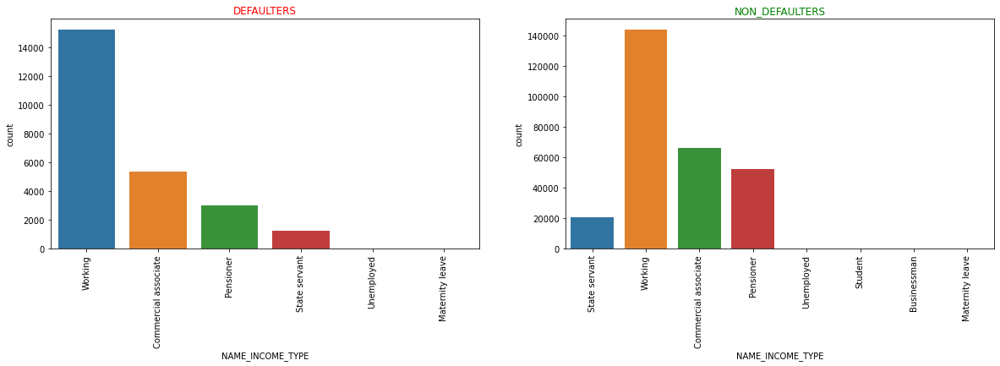

In [78]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
sns.countplot(default.NAME_INCOME_TYPE)
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation = 90)

plt.subplot(1,2,2)
sns.countplot(n_default.NAME_INCOME_TYPE)
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation = 90)

plt.show()

**Observations :**

1) More people from "Working" category tend to apply for loans.

2) "Commercial associate", "State servant" and "Pensioner" categories are tend to be Non-defaulters

3) "Working" category of people are tend to be defaulters

#### CODE_GENDER

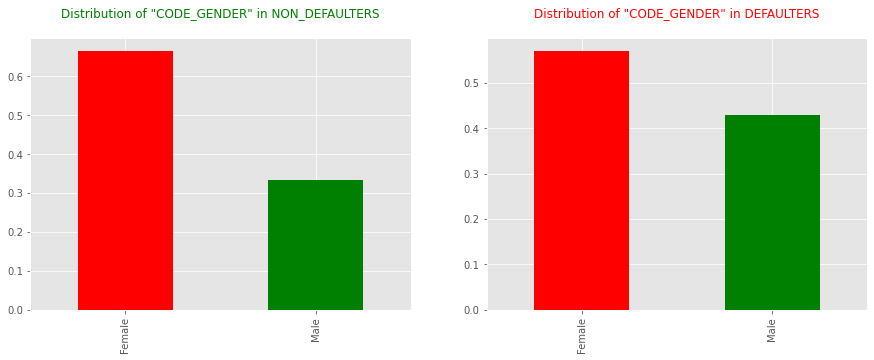

In [150]:


plt.figure(figsize = [15,5])

plt.subplot(1,2,1)
n_default.CODE_GENDER.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('Distribution of "CODE_GENDER" in NON_DEFAULTERS\n', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.subplot(1,2,2)
default.CODE_GENDER.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('Distribution of "CODE_GENDER" in DEFAULTERS\n', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.show()

**Observation :**

1) In defaulters data more than 55% is contributed by females and closely 45% is contributed by males.

2) In non-defaulters data more than 65% is contributed by females and closely only 35% is contributed by males.

3) we can see that more female are applying for loan than men. 

4) The ratio of defaulters to non-defaulters female defaulters is low compare to male.

5) Male clients are tend to be defaulters


#### FLAG_OWN_CAR

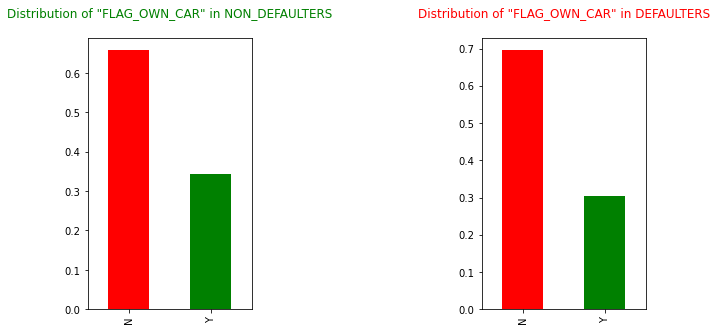

In [80]:
plt.figure(figsize = [10,5])
plt.subplot(1,3,1)
n_default.FLAG_OWN_CAR.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('Distribution of "FLAG_OWN_CAR" in NON_DEFAULTERS\n', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.subplot(1,3,3)
default.FLAG_OWN_CAR.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('Distribution of "FLAG_OWN_CAR" in DEFAULTERS\n', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.show()

**Observation :**

Here people who don't have car contribute more percentage to defaulters than the people who have car.

#### NAME_FAMILY_STATUS

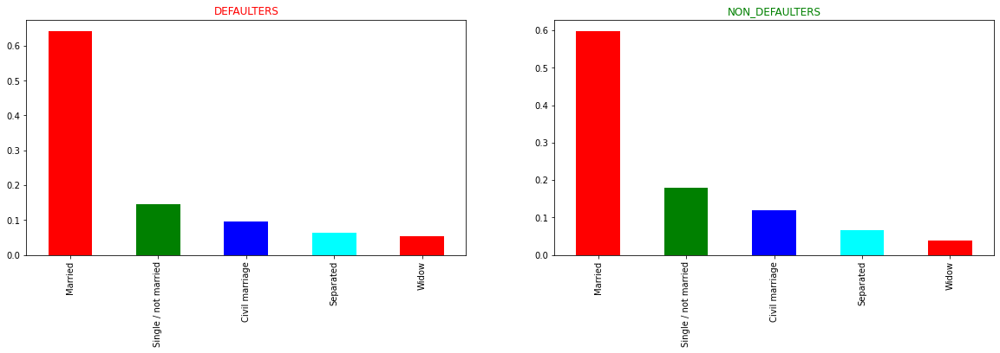

In [81]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
n_default.NAME_FAMILY_STATUS.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
default.NAME_FAMILY_STATUS.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observation :**

1) Here Married and Widow category of people are more likely to be a Defaulter

2) Single/not married, Civil marriage, Separated category of people are more likely to be a Non-Defaulter

3) Married people are the ones who are applying for more loans compare to other category of people

#### FLAG_OWN_REALTY

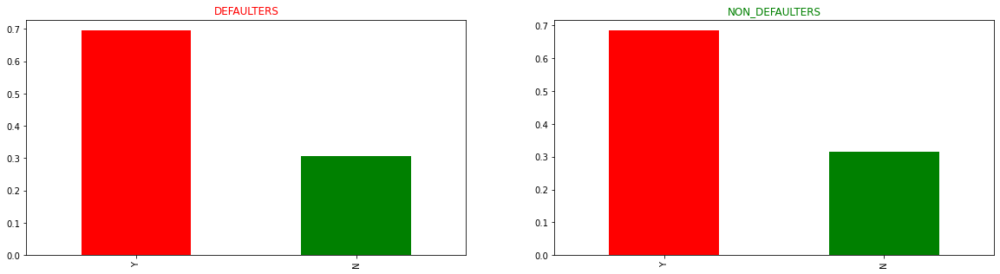

In [82]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
n_default.FLAG_OWN_REALTY.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
default.FLAG_OWN_REALTY.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observation :**

A client who owns a house or flat is the one who is applying for more loans than the ones who doesn't own.

#### ORGANIZATION_TYPE

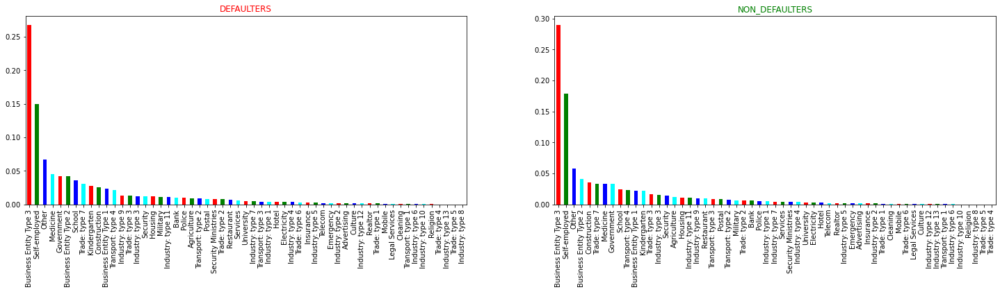

In [83]:
plt.figure(figsize = [25,5])
plt.subplot(1,2,1)
n_default.ORGANIZATION_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
default.ORGANIZATION_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observations :**

Business ENtity Type 3 organizations are taking more loans compare to other organizations, so more than 25% of them are in both defaulters and non-defaulters category

#### NAME_HOUSING_TYPE

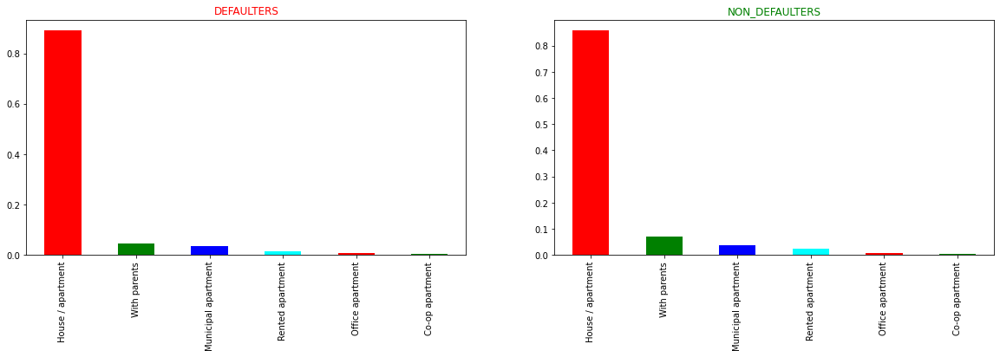

In [84]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
n_default.NAME_HOUSING_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
default.NAME_HOUSING_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observations :**

1) House / apartment type category of people are the ones who are applying for more loans (> 80%) compare to other category.
 
2) If the people are living with parents then they are more to be in Non-Defaulters category

#### NAME_CONTRACT_TYPE

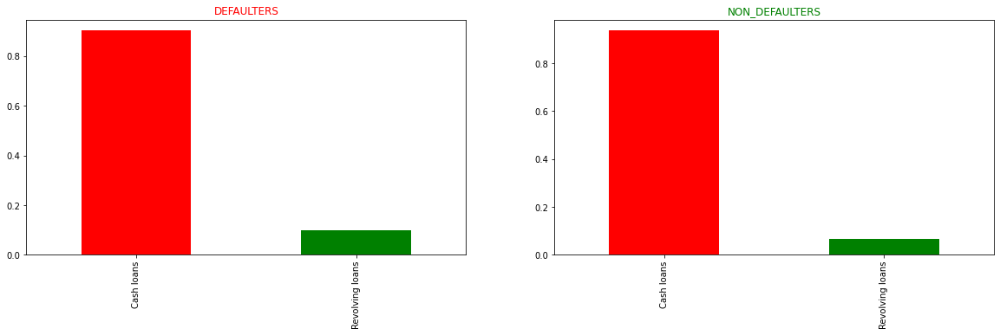

In [85]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
n_default.NAME_CONTRACT_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
default.NAME_CONTRACT_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green'])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observations :**

1) Most of the people are applying for Cash loans rather than Revolving loans

2) The people who took Revolving loans are more likely to become a defaulter than non-defaulter 

#### OCCUPATION_TYPE

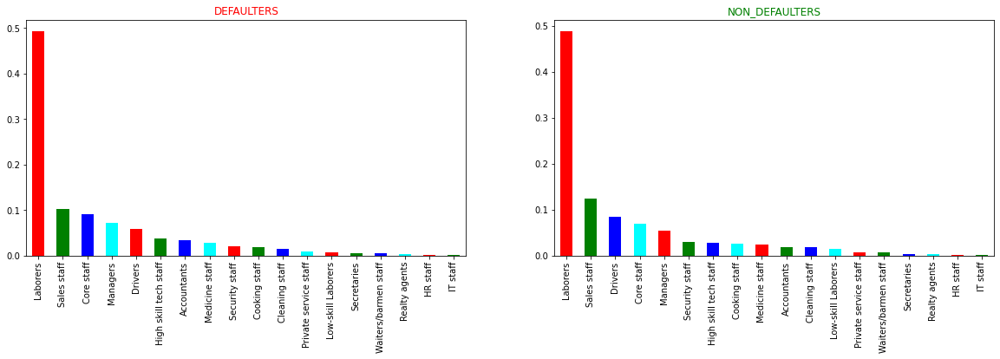

In [86]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
n_default.OCCUPATION_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
default.OCCUPATION_TYPE.value_counts(normalize = True).plot.bar(color=['red', 'green', 'blue', 'cyan'])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observations :**

1) Most of the loans are taken by "Laborers" category

2) "Sales staff" is more tend to be Non-defaulters 

#### REGION_RATING_CLIENT

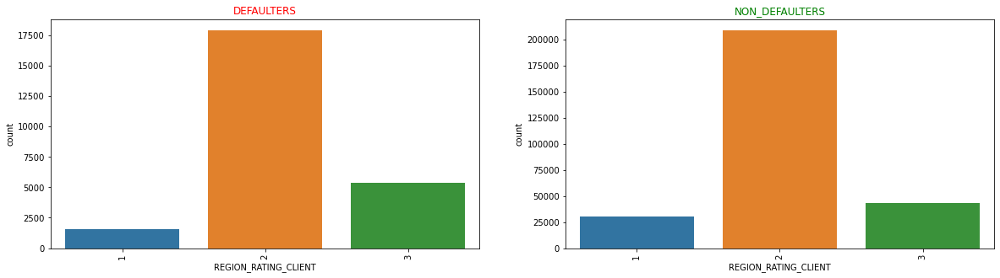

In [87]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
sns.countplot(default.REGION_RATING_CLIENT)
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation = 90)

plt.subplot(1,2,2)
sns.countplot(n_default.REGION_RATING_CLIENT)
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation = 90)

plt.show()

**Observations :**

1) People belonging to 2nd tire are more tend to apply for loans

2) People living in better areas (rating 3) tend to contribute more to the defaulters.

3) People living in one rating regions tend to contribute more to the Non-defaulters.


<h2 style = "color : Orange"> Categorical Ordered Univariate Analysis </h2>


#### AGE_GROUP

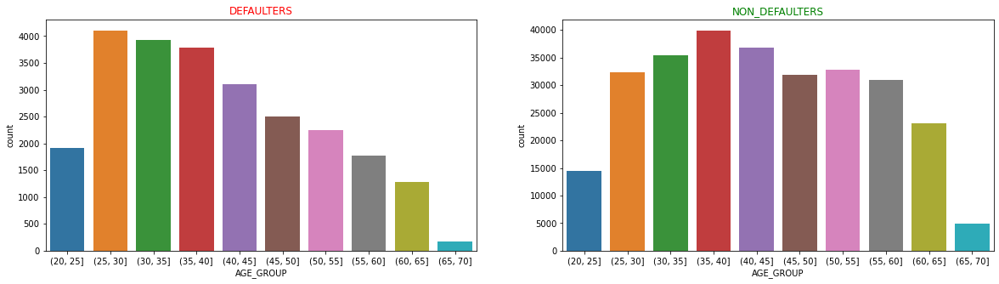

In [88]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
sns.countplot(default.AGE_GROUP)
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
sns.countplot(n_default.AGE_GROUP)
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observations :**

1) Riskiest to loan : We can see that the people belong to the age from 20 to 35 tend to default more.

2) Along with the increase in age of people they tend to less default. So risk to loan decreases with increase in age of        people.

#### INCOME_GROUP

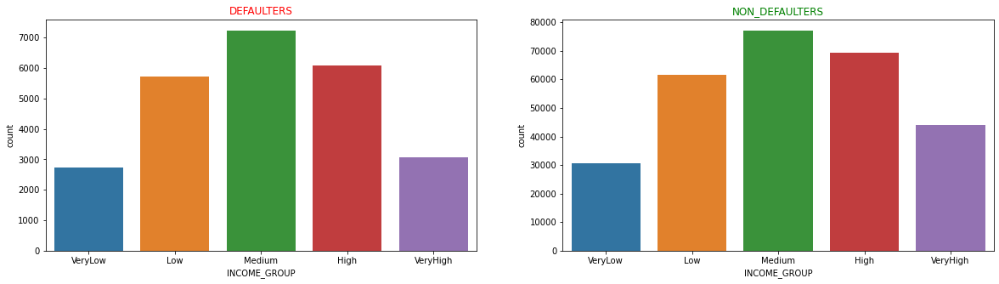

In [89]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
sns.countplot(default.INCOME_GROUP)
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})

plt.subplot(1,2,2)
sns.countplot(n_default.INCOME_GROUP)
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})

plt.show()

**Observations :**

The people with **High and Very high** income are less tend to default so they are safe to approvide loan.

#### NAME_EDUCATION_TYPE

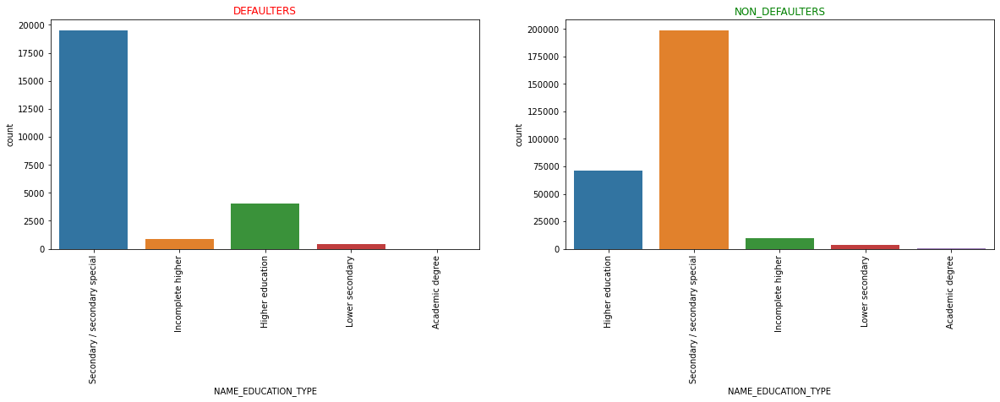

In [90]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
sns.countplot(default.NAME_EDUCATION_TYPE)
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation = 90)

plt.subplot(1,2,2)
sns.countplot(n_default.NAME_EDUCATION_TYPE)
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation = 90)

plt.show()

**Observations :**

1) Most of the loan applied by "Secondary / Secondary special" education type

2) "Higher education" is more tend to be Non-defaulter

<h2 style = "color : Orange"> Continuous Univariate Analysis </h2>


#### CNT_FAM_MEMBERS

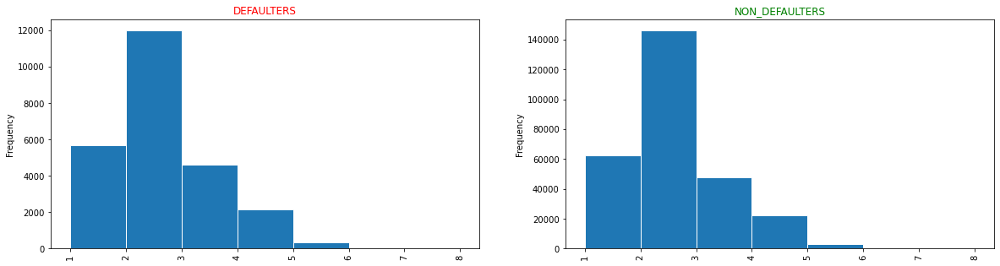

In [91]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
default.CNT_FAM_MEMBERS.plot.hist(edgecolor = 'w', bins = [1,2,3,4,5,6,7,8])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation = 90)

plt.subplot(1,2,2)
n_default.CNT_FAM_MEMBERS.plot.hist(edgecolor = 'w', bins = [1,2,3,4,5,6,7,8])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation = 90)

plt.show()

**Observations :**

Family of 2 or 3 apply for loans more often

#### CNT_CHILDREN

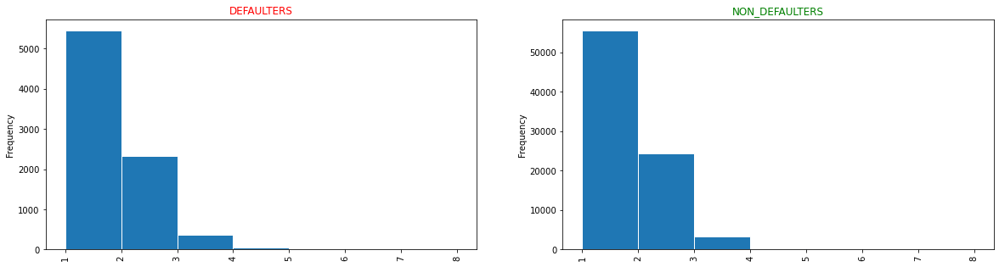

In [92]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
default.CNT_CHILDREN.plot.hist(edgecolor = 'w', bins = [1,2,3,4,5,6,7,8])
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation = 90)

plt.subplot(1,2,2)
n_default.CNT_CHILDREN.plot.hist(edgecolor = 'w', bins = [1,2,3,4,5,6,7,8])
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation = 90)

plt.show()

**Observation :**

Family of 1 or 2 children apply for loans more often

<h1 style = "color : Blue"> Bivariate and Multivariate analysis </h1>


#### 'AMT_CREDIT' Vs 'CNT_FAM_MEMBERS'

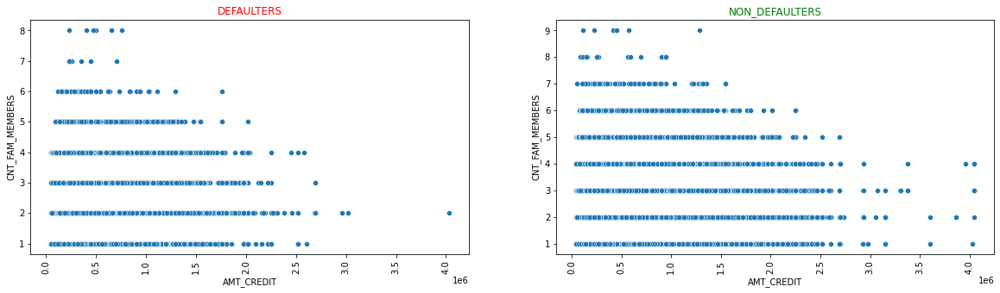

In [93]:

plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
sns.scatterplot(data = default, x = 'AMT_CREDIT', y = 'CNT_FAM_MEMBERS')
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation = 90)

plt.subplot(1,2,2)
sns.scatterplot(data = n_default, x = 'AMT_CREDIT', y = 'CNT_FAM_MEMBERS')
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation = 90)

plt.show()

**Observations :**

1) Families with large number of people default less often and the amount of credit is low for them

2) Families with less number of people default often with low credit amount

#### AMT_CREDIT    -    CNT_CHILDREN

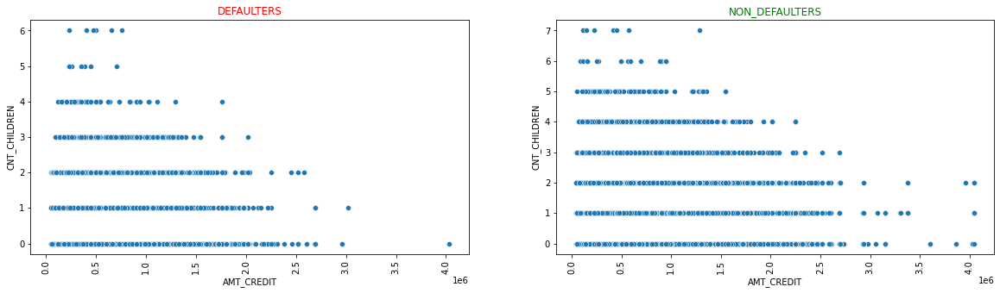

In [94]:
plt.figure(figsize = [20,5])
plt.subplot(1,2,1)
sns.scatterplot(data = default, x = 'AMT_CREDIT', y = 'CNT_CHILDREN')
plt.title('DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation = 90)

plt.subplot(1,2,2)
sns.scatterplot(data = n_default, x = 'AMT_CREDIT', y = 'CNT_CHILDREN')
plt.title('NON_DEFAULTERS', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation = 90)

plt.show()

**Observations :**

1) If the number of children is high then they tend to default less and the amount of credit is low

2)  Families with less number of children default often with low credit amount

#### Income  Vs  Credit,  Goods  price  Vs  Credit

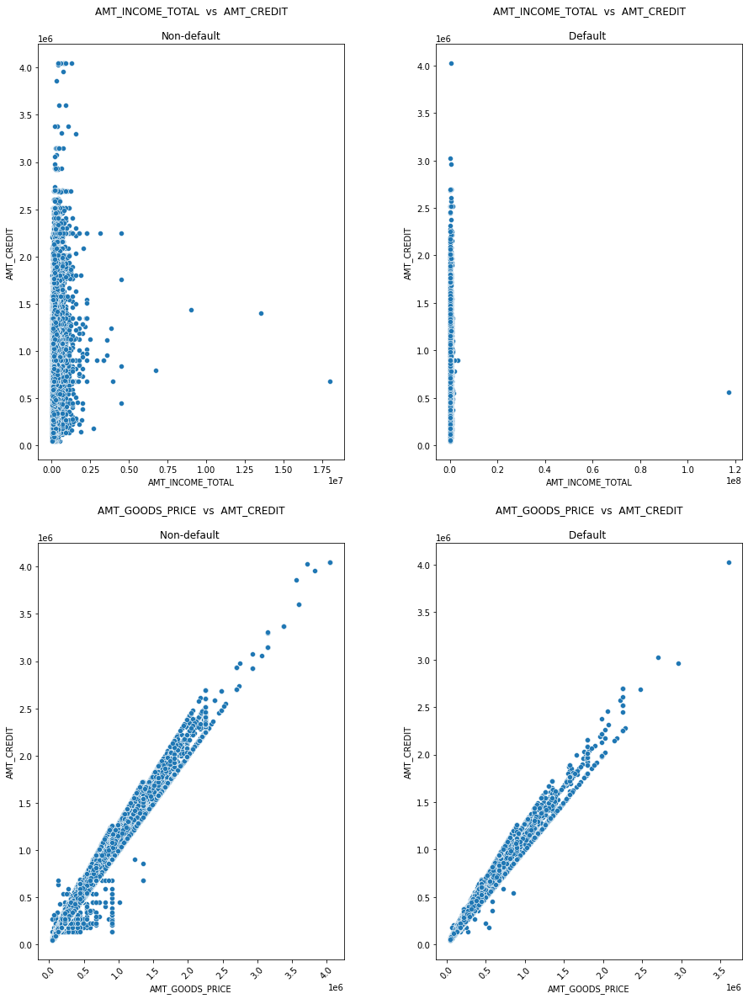

In [95]:
#Scatter plot for numeric columns

plt.figure(figsize = (15, 20))
plt.subplots_adjust(wspace=0.3)


plt.subplot(2,2,1)
sns.scatterplot(n_default.AMT_INCOME_TOTAL,n_default.AMT_CREDIT)
plt.xlabel('AMT_INCOME_TOTAL')
plt.ylabel('AMT_CREDIT')
plt.title('AMT_INCOME_TOTAL  vs  AMT_CREDIT\n\nNon-default')

plt.subplot(2,2,2)
sns.scatterplot(default.AMT_INCOME_TOTAL,default.AMT_CREDIT)
plt.xlabel('AMT_INCOME_TOTAL')
plt.ylabel('AMT_CREDIT')
plt.title('AMT_INCOME_TOTAL  vs  AMT_CREDIT\n\nDefault ')

plt.subplot(2,2,3)
sns.scatterplot(n_default.AMT_GOODS_PRICE,n_default.AMT_CREDIT)
plt.xlabel('AMT_GOODS_PRICE')
plt.ylabel('AMT_CREDIT')
plt.title('AMT_GOODS_PRICE  vs  AMT_CREDIT\n\nNon-default ')
plt.xticks(rotation = 45)

plt.subplot(2,2,4)
sns.scatterplot(default.AMT_GOODS_PRICE,default.AMT_CREDIT)
plt.xlabel('AMT_GOODS_PRICE')
plt.ylabel('AMT_CREDIT')
plt.title('AMT_GOODS_PRICE  vs  AMT_CREDIT\n\nDefault ')
plt.xticks(rotation = 45)
plt.show()

**Observations :**

1) Those who have paid the loan amount on/within time (Non - defaulters)are more likely to get higher credits than those who didnt pay/did late payments(Defaulters). 

2) People who have higher goods price and have made payments on time (Non - defaulters)have higher credits than those with higher goods price but didn't pay loan.

#### Income range  -  Gender

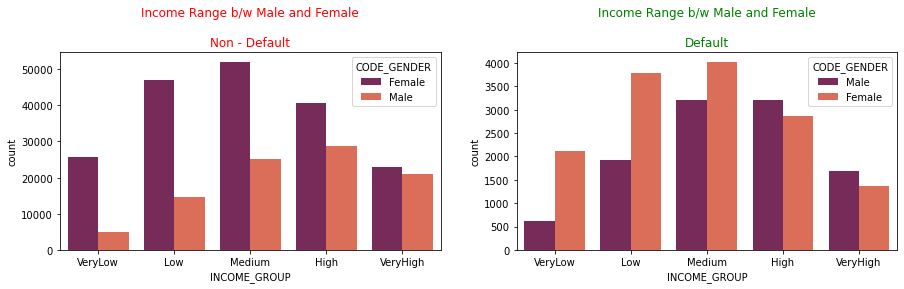

In [96]:
plt.figure(figsize = (15, 8))

plt.subplot(2, 2, 1)
plt.title('Income Range b/w Male and Female\n\nNon - Default',fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
sns.countplot(x='INCOME_GROUP', hue='CODE_GENDER', data=n_default, palette='rocket')


plt.subplot(2, 2, 2)
plt.title('Income Range b/w Male and Female\n\nDefault', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
sns.countplot(x='INCOME_GROUP', hue='CODE_GENDER', data=default,palette='rocket')

plt.show()

**Observations :**
    
1) Male in low income range is more tend to be a defaulter

2) Most of the loans are applied by females.

#### Credit Amount - Education Status

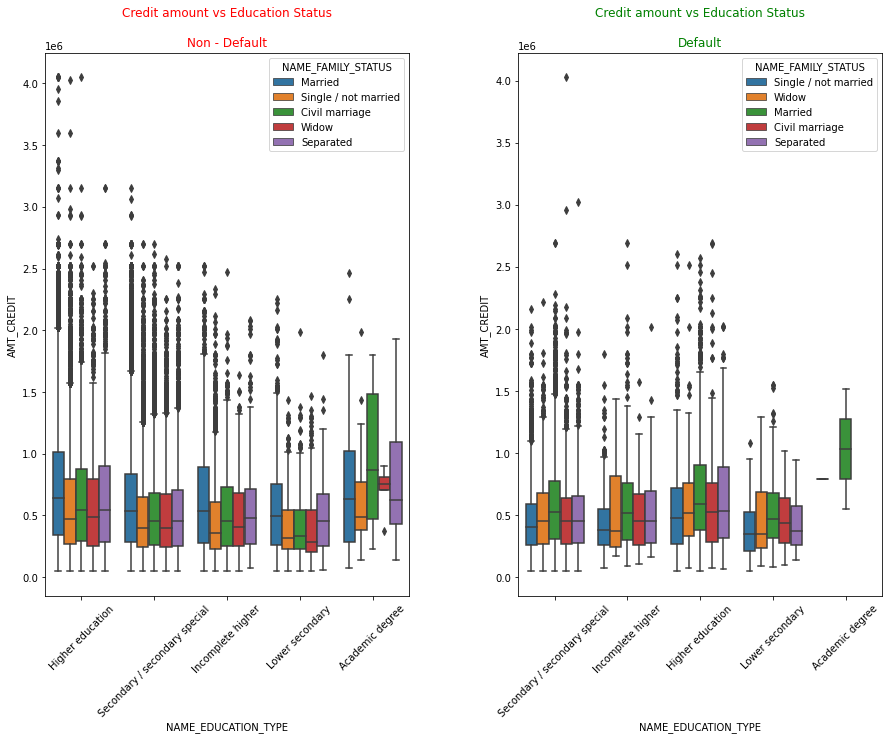

In [97]:
# Box plotting for Credit amount

plt.figure(figsize=(15,10))
plt.subplots_adjust(wspace=0.3)

plt.subplot(121)
sns.boxplot(data = n_default, x='NAME_EDUCATION_TYPE',y='AMT_CREDIT', hue ='NAME_FAMILY_STATUS',orient='v]')
plt.title('Credit amount vs Education Status\n\nNon - Default', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation=45)

plt.subplot(122)
sns.boxplot(data =default, x='NAME_EDUCATION_TYPE',y='AMT_CREDIT', hue ='NAME_FAMILY_STATUS',orient='v]')
plt.title('Credit amount vs Education Status\n\nDefault', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation=45)
plt.show()

**Observations :**
    
1) Highly educated persons are tend to be a Non - Defaulter

2) Highly educated married people with high credit amount are tend to be Non - defaulter

3) People in "Higher education" and "Secondary / secondary special" are tend to be non - defaulter

4) In "Academic degree" married people are tend to be defaulter.


#### Income - Education Status

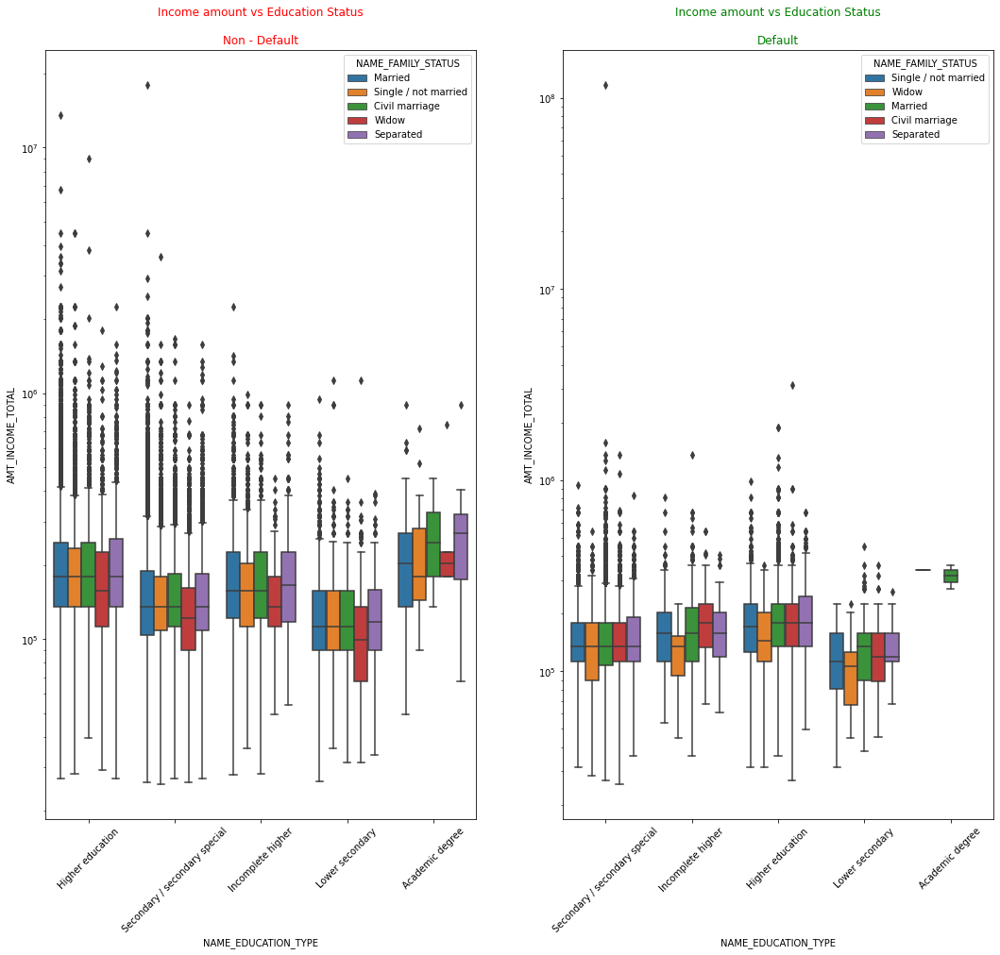

In [98]:
# Box plotting for Income amount in logarithmic scale

plt.figure(figsize=(18,15))
plt.subplot(1,2,1)
plt.yscale('log')
sns.boxplot(data = n_default, x='NAME_EDUCATION_TYPE',y='AMT_INCOME_TOTAL', hue ='NAME_FAMILY_STATUS',orient='v')
plt.title('Income amount vs Education Status\n\nNon - Default', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Red'})
plt.xticks(rotation=45)



plt.subplot(1,2,2)
plt.yscale('log')
sns.boxplot(data =default, x='NAME_EDUCATION_TYPE',y='AMT_INCOME_TOTAL', hue ='NAME_FAMILY_STATUS',orient='v')
plt.title('Income amount vs Education Status\n\nDefault', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.xticks(rotation=45)
plt.show()

**observations :**
    
1) Higher educated married people with higher Income are tend to be Non - defaulter

2) People with higher education who have lesser income are tend to be defaulter

3) Secondary / secondary special with low income are tend to be a defaulter.

#### Top 10 correlation for Defaulters

In [99]:
corr=default[['AMT_GOODS_PRICE','AMT_INCOME_TOTAL','AMT_ANNUITY','DAYS_EMPLOYED',
  'AGE_GROUP', 'DAYS_REGISTRATION',
  'AMT_CREDIT']].corr(method = 'pearson')
corr=corr.where(np.triu(np.ones(corr.shape),k=1).astype(np.bool))
corr_df=corr.unstack().reset_index()

In [100]:
corr_df.columns = ['VAR1','VAR2','CORRELATION']
corr_df.dropna(subset=['CORRELATION'],inplace=True)
corr_df['CORR_ABS']=corr_df['CORRELATION'].abs()

In [101]:
corr_df.sort_values('CORR_ABS', ascending=False).head(10)

,VAR1,VAR2,CORRELATION,CORR_ABS
30,AMT_CREDIT,AMT_GOODS_PRICE,0.983104,0.983104
12,AMT_ANNUITY,AMT_GOODS_PRICE,0.752693,0.752693
32,AMT_CREDIT,AMT_ANNUITY,0.752184,0.752184
27,DAYS_REGISTRATION,DAYS_EMPLOYED,0.192439,0.192439
20,DAYS_EMPLOYED,AMT_ANNUITY,-0.081194,0.081194
13,AMT_ANNUITY,AMT_INCOME_TOTAL,0.046416,0.046416
31,AMT_CREDIT,AMT_INCOME_TOTAL,0.038123,0.038123
6,AMT_INCOME_TOTAL,AMT_GOODS_PRICE,0.037574,0.037574
26,DAYS_REGISTRATION,AMT_ANNUITY,-0.034262,0.034262
34,AMT_CREDIT,DAYS_REGISTRATION,0.025874,0.025874


# Data Set 2: Previous Application

In [102]:
p_app = pd.read_csv('previous_application.csv')

In [103]:
p_app.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [104]:
p_app.shape

(1670214, 37)

In [105]:
p_app.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,5951.000000,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,0.188357,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,0.087671,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,0.034781,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,0.160716,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,0.189122,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,0.193330,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,1.000000,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


In [106]:
p_app.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

# DATA cleaning

In [107]:
p_app.isnull().sum()

SK_ID_PREV                           0
SK_ID_CURR                           0
NAME_CONTRACT_TYPE                   0
AMT_ANNUITY                     372235
AMT_APPLICATION                      0
AMT_CREDIT                           1
AMT_DOWN_PAYMENT                895844
AMT_GOODS_PRICE                 385515
WEEKDAY_APPR_PROCESS_START           0
HOUR_APPR_PROCESS_START              0
FLAG_LAST_APPL_PER_CONTRACT          0
NFLAG_LAST_APPL_IN_DAY               0
RATE_DOWN_PAYMENT               895844
RATE_INTEREST_PRIMARY          1664263
RATE_INTEREST_PRIVILEGED       1664263
NAME_CASH_LOAN_PURPOSE               0
NAME_CONTRACT_STATUS                 0
DAYS_DECISION                        0
NAME_PAYMENT_TYPE                    0
CODE_REJECT_REASON                   0
NAME_TYPE_SUITE                 820405
NAME_CLIENT_TYPE                     0
NAME_GOODS_CATEGORY                  0
NAME_PORTFOLIO                       0
NAME_PRODUCT_TYPE                    0
CHANNEL_TYPE             

In [108]:
(p_app.isnull().sum() / p_app.shape[0] * 100).sort_values(ascending = False)

RATE_INTEREST_PRIVILEGED       99.643698
RATE_INTEREST_PRIMARY          99.643698
AMT_DOWN_PAYMENT               53.636480
RATE_DOWN_PAYMENT              53.636480
NAME_TYPE_SUITE                49.119754
NFLAG_INSURED_ON_APPROVAL      40.298129
DAYS_TERMINATION               40.298129
DAYS_LAST_DUE                  40.298129
DAYS_LAST_DUE_1ST_VERSION      40.298129
DAYS_FIRST_DUE                 40.298129
DAYS_FIRST_DRAWING             40.298129
AMT_GOODS_PRICE                23.081773
AMT_ANNUITY                    22.286665
CNT_PAYMENT                    22.286366
PRODUCT_COMBINATION             0.020716
AMT_CREDIT                      0.000060
NAME_YIELD_GROUP                0.000000
NAME_PORTFOLIO                  0.000000
NAME_SELLER_INDUSTRY            0.000000
SELLERPLACE_AREA                0.000000
CHANNEL_TYPE                    0.000000
NAME_PRODUCT_TYPE               0.000000
SK_ID_PREV                      0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_CLIENT_TYPE

In [109]:
# Creating a data frame named 'null_col' containing the columns with > 45% null values in  'p_app' data
null_col = p_app.isnull().sum() / app.shape[0] * 100
null_col = null_col[null_col.values > 45]
null_col

AMT_ANNUITY                  121.059119
AMT_DOWN_PAYMENT             291.348437
AMT_GOODS_PRICE              125.378071
RATE_DOWN_PAYMENT            291.348437
RATE_INTEREST_PRIMARY        541.255423
RATE_INTEREST_PRIVILEGED     541.255423
NAME_TYPE_SUITE              266.813992
CNT_PAYMENT                  121.057493
DAYS_FIRST_DRAWING           218.895740
DAYS_FIRST_DUE               218.895740
DAYS_LAST_DUE_1ST_VERSION    218.895740
DAYS_LAST_DUE                218.895740
DAYS_TERMINATION             218.895740
NFLAG_INSURED_ON_APPROVAL    218.895740
dtype: float64

In [110]:
# number of columns with percentage of null values > 45%
null_col.shape

(14,)

In [111]:
# droping the columns containg more than 45% null values
p_app.drop(null_col.index, axis = 1, inplace = True)

In [112]:
p_app.shape

(1670214, 23)

In [113]:
# columns having null values
print(len(p_app.columns[p_app.isnull().any()].tolist()))
p_app.columns[p_app.isnull().any()].tolist()

2


['AMT_CREDIT', 'PRODUCT_COMBINATION']

#### AMT_CREDIT

In [114]:
p_app.AMT_CREDIT.describe()

count    1.670213e+06
mean     1.961140e+05
std      3.185746e+05
min      0.000000e+00
25%      2.416050e+04
50%      8.054100e+04
75%      2.164185e+05
max      6.905160e+06
Name: AMT_CREDIT, dtype: float64

In [115]:
p_app.AMT_CREDIT.isnull().sum()

1

In [116]:
# imputing median on null value 
p_app.AMT_CREDIT.fillna(p_app.AMT_CREDIT.median(), inplace = True)

In [117]:
p_app.AMT_CREDIT.isnull().sum()

0

#### PRODUCT_COMBINATION

In [118]:
p_app.PRODUCT_COMBINATION.describe()

count     1669868
unique         17
top          Cash
freq       285990
Name: PRODUCT_COMBINATION, dtype: object

In [119]:
p_app.PRODUCT_COMBINATION.isnull().sum()

346

In [120]:
p_app.PRODUCT_COMBINATION.value_counts()

Cash                              285990
POS household with interest       263622
POS mobile with interest          220670
Cash X-Sell: middle               143883
Cash X-Sell: low                  130248
Card Street                       112582
POS industry with interest         98833
POS household without interest     82908
Card X-Sell                        80582
Cash Street: high                  59639
Cash X-Sell: high                  59301
Cash Street: middle                34658
Cash Street: low                   33834
POS mobile without interest        24082
POS other with interest            23879
POS industry without interest      12602
POS others without interest         2555
Name: PRODUCT_COMBINATION, dtype: int64

In [121]:
p_app.PRODUCT_COMBINATION.mode()[0]

'Cash'

In [122]:
# imputing mode on null value column
p_app.PRODUCT_COMBINATION.fillna(p_app.PRODUCT_COMBINATION.mode()[0], inplace = True)

In [123]:
p_app.PRODUCT_COMBINATION.isnull().sum()

0

#### Replacing XNA and XAP with null


In [124]:

# XNA and XAP are replaced by NaN
p_app=p_app.replace('XNA', np.NaN)
p_app=p_app.replace('XAP', np.NaN)

In [125]:
p_app.head() 

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_APPLICATION,AMT_CREDIT,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,NAME_YIELD_GROUP,PRODUCT_COMBINATION
0,2030495,271877,Consumer loans,17145.0,17145.0,SATURDAY,15,Y,1,NaN,Approved,-73,Cash through the bank,NaN,Repeater,Mobile,POS,NaN,Country-wide,35,Connectivity,middle,POS mobile with interest
1,2802425,108129,Cash loans,607500.0,679671.0,THURSDAY,11,Y,1,NaN,Approved,-164,NaN,NaN,Repeater,NaN,Cash,x-sell,Contact center,-1,NaN,low_action,Cash X-Sell: low
2,2523466,122040,Cash loans,112500.0,136444.5,TUESDAY,11,Y,1,NaN,Approved,-301,Cash through the bank,NaN,Repeater,NaN,Cash,x-sell,Credit and cash offices,-1,NaN,high,Cash X-Sell: high
3,2819243,176158,Cash loans,450000.0,470790.0,MONDAY,7,Y,1,NaN,Approved,-512,Cash through the bank,NaN,Repeater,NaN,Cash,x-sell,Credit and cash offices,-1,NaN,middle,Cash X-Sell: middle
4,1784265,202054,Cash loans,337500.0,404055.0,THURSDAY,9,Y,1,Repairs,Refused,-781,Cash through the bank,HC,Repeater,NaN,Cash,walk-in,Credit and cash offices,-1,NaN,high,Cash Street: high


#### Removing unwated column for analysis

In [126]:
p_app.drop(['WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START', 'FLAG_LAST_APPL_PER_CONTRACT', 
            'NFLAG_LAST_APPL_IN_DAY'], inplace = True, axis = 1)

<h2 style = "color : Orange"> Categorical columns </h2>


In [127]:
# Categorical columns
list(set(p_app.columns) - set(p_app.describe().columns))

['CODE_REJECT_REASON',
 'PRODUCT_COMBINATION',
 'NAME_PRODUCT_TYPE',
 'NAME_CONTRACT_TYPE',
 'NAME_PORTFOLIO',
 'CHANNEL_TYPE',
 'NAME_CASH_LOAN_PURPOSE',
 'NAME_CLIENT_TYPE',
 'NAME_CONTRACT_STATUS',
 'NAME_GOODS_CATEGORY',
 'NAME_SELLER_INDUSTRY',
 'NAME_YIELD_GROUP',
 'NAME_PAYMENT_TYPE']

<h2 style = "color : Orange"> Numeric columns </h2>


In [128]:
# Numeric columns
p_app.describe().columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'AMT_APPLICATION', 'AMT_CREDIT',
       'DAYS_DECISION', 'SELLERPLACE_AREA'],
      dtype='object')

In [129]:
p_app.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_APPLICATION',
       'AMT_CREDIT', 'NAME_CASH_LOAN_PURPOSE', 'NAME_CONTRACT_STATUS',
       'DAYS_DECISION', 'NAME_PAYMENT_TYPE', 'CODE_REJECT_REASON',
       'NAME_CLIENT_TYPE', 'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO',
       'NAME_PRODUCT_TYPE', 'CHANNEL_TYPE', 'SELLERPLACE_AREA',
       'NAME_SELLER_INDUSTRY', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION'],
      dtype='object')

<h2 style = "color : Orange">  Univariate Analysis On Previous Application Data</h2>


#### NAME_CONTRACT_STATUS

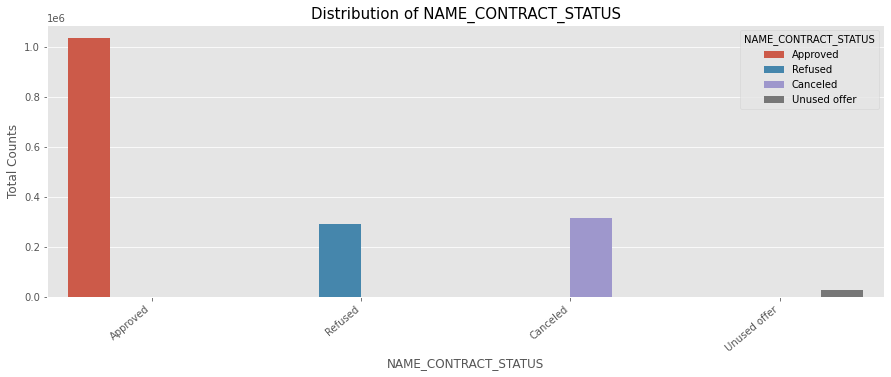

In [130]:
plt.style.use('ggplot')
sns.despine
fig,ax = plt.subplots(1,1,figsize=(15,5))
    
sns.countplot(x = 'NAME_CONTRACT_STATUS', data=p_app,ax = ax,hue = 'NAME_CONTRACT_STATUS')
ax.set_ylabel('Total Counts')
ax.set_title(f'Distribution of NAME_CONTRACT_STATUS',fontsize=15)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    
plt.show()

**Observations :**
    
We can observe that majority of loans are approved and very less percentage of loans are unused offer

#### NAME_CONTRACT_TYPE

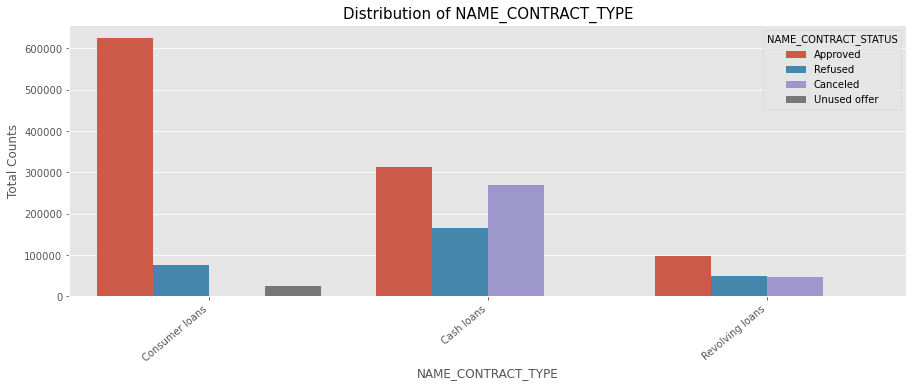

In [131]:
plt.style.use('ggplot')
sns.despine
fig,ax = plt.subplots(1,1,figsize=(15,5))
    
sns.countplot(x = 'NAME_CONTRACT_TYPE', data=p_app,ax = ax,hue = 'NAME_CONTRACT_STATUS')
ax.set_ylabel('Total Counts')
ax.set_title(f'Distribution of NAME_CONTRACT_TYPE',fontsize=15)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    
plt.show()

**Observations :**
    
1) most of the applications are for 'Cash loan' and 'Consumer loan'. 

2) the cash loans are refused and Cancelled more often than others.

3) Unused offer is very less

#### NAME_PAYMENT_TYPE

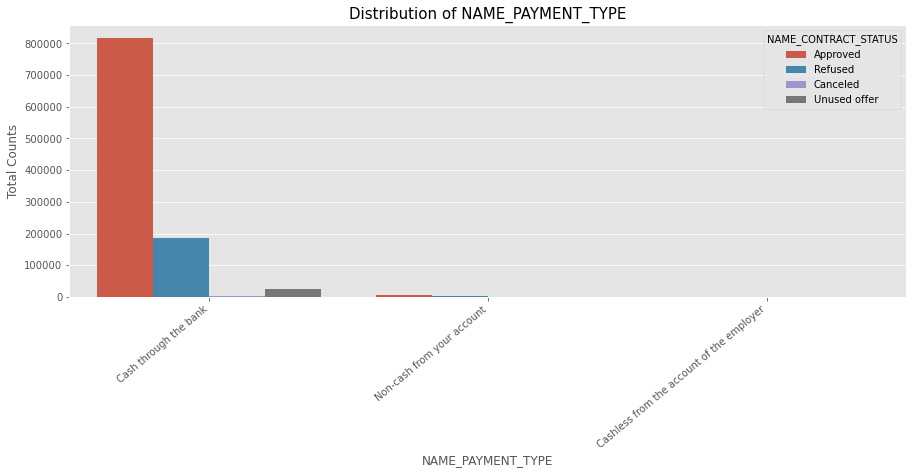

In [132]:
plt.style.use('ggplot')
sns.despine
fig,ax = plt.subplots(1,1,figsize=(15,5))
    
sns.countplot(x = 'NAME_PAYMENT_TYPE', data=p_app,ax = ax,hue = 'NAME_CONTRACT_STATUS')
ax.set_ylabel('Total Counts')
ax.set_title(f'Distribution of NAME_PAYMENT_TYPE',fontsize=15)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    
plt.show()

**Observations :**
    
1) most of the clients chose to repay the loan using the 'Cash through the bank' option

2) 'Non-Cash from your account' & 'Cashless from the account of the employee' options are not at all popular in terms of loan repayment amongst the customers.


#### NAME_CLIENT_TYPE

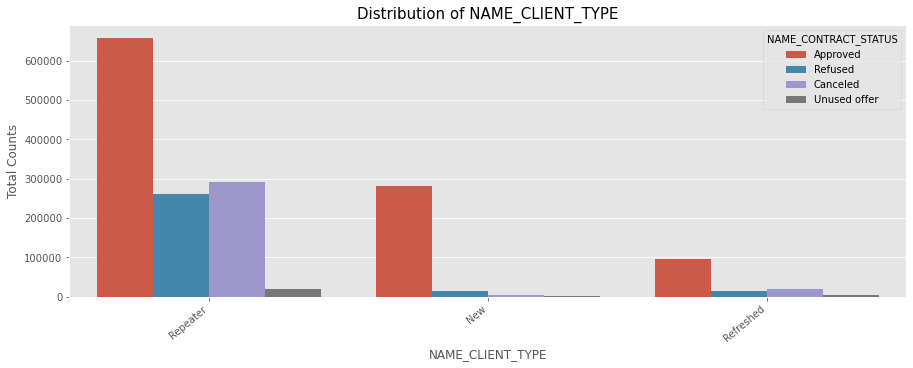

In [133]:
plt.style.use('ggplot')
sns.despine
fig,ax = plt.subplots(1,1,figsize=(15,5))
    
sns.countplot(x = 'NAME_CLIENT_TYPE', data=p_app,ax = ax,hue = 'NAME_CONTRACT_STATUS')
ax.set_ylabel('Total Counts')
ax.set_title(f'Distribution of NAME_CLIENT_TYPE',fontsize=15)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    
plt.show()

**Observations :**
    
1) Most of the loan applications are from repeat customers. 

2) They also get refused most often.

3) The percentage of new customers is low and they also got refused less

#### CODE_REJECT_REASON

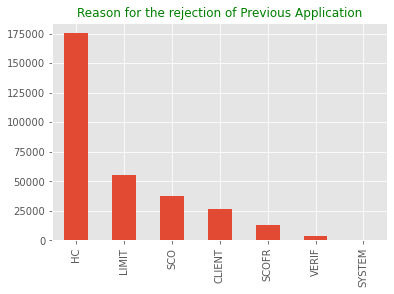

In [134]:
p_app.CODE_REJECT_REASON.value_counts().plot.bar()
plt.title('Reason for the rejection of Previous Application', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.show()

**Observations :**
    
HC is the reason for the rejection for most of the previous applications.

#### CHANNEL_TYPE

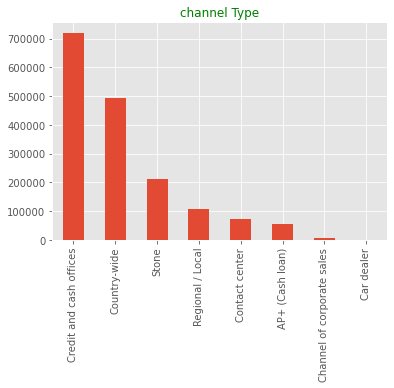

In [135]:
p_app.CHANNEL_TYPE.value_counts().plot.bar()
plt.title('channel Type', fontdict = {'fontsize': 12, 'fontweight': 5, 'color':'Green'})
plt.show()

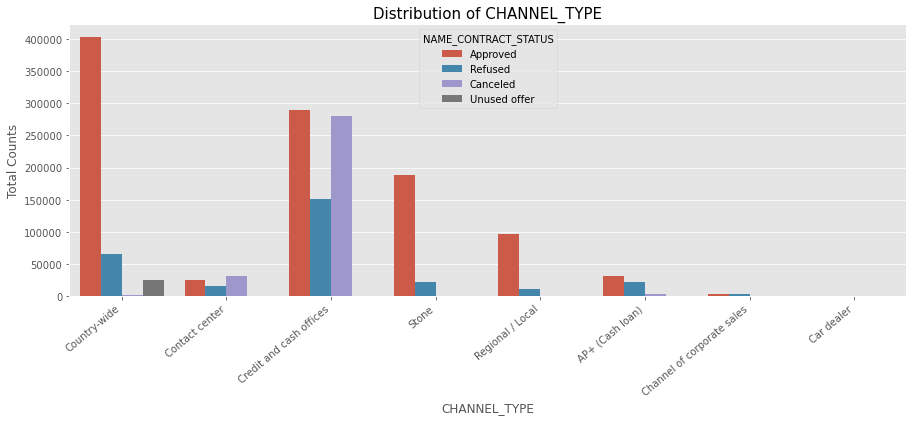

In [136]:
plt.style.use('ggplot')
sns.despine
fig,ax = plt.subplots(1,1,figsize=(15,5))
    
sns.countplot(x = 'CHANNEL_TYPE', data=p_app,ax = ax,hue = 'NAME_CONTRACT_STATUS')
ax.set_ylabel('Total Counts')
ax.set_title(f'Distribution of CHANNEL_TYPE',fontsize=15)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    
plt.show()

**Observations :**

1) Through Credit and cash offices and country wide channel bank got the most of the client on previous application

2) The refusing rate is high in Credit and cash offices channel

#### Top Correlations on Previous Application Data

In [137]:
df_corr_prev = p_app.drop(axis = 1,columns = ['SK_ID_CURR','SK_ID_PREV'] )

correlation =df_corr_prev.corr().abs()

In [138]:
corr_prev = correlation.where(np.triu(np.ones(correlation.shape),k=1).astype(np.bool)).unstack().reset_index()
corr_prev.columns = ['Var1','Var2','Correlation']
corr_prev.dropna(subset = ['Correlation'],inplace=True)
corr_prev = corr_prev.sort_values(by=['Correlation'], ascending=False)

corr_prev


,Var1,Var2,Correlation
4,AMT_CREDIT,AMT_APPLICATION,0.975824
9,DAYS_DECISION,AMT_CREDIT,0.133763
8,DAYS_DECISION,AMT_APPLICATION,0.133660
14,SELLERPLACE_AREA,DAYS_DECISION,0.018382
13,SELLERPLACE_AREA,AMT_CREDIT,0.009567
12,SELLERPLACE_AREA,AMT_APPLICATION,0.007649


#### NAME_CONTRACT_STATUS  -  NAME_CLIENT_TYPE  -  AMT_APPLICATION

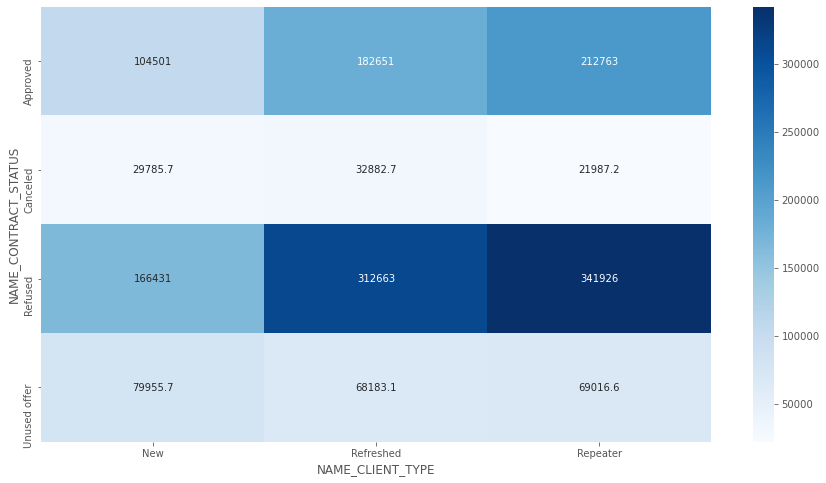

In [139]:
# Checking contract status vs name client type aggregating over application amount

res = pd.pivot_table(data=p_app, index="NAME_CONTRACT_STATUS",columns='NAME_CLIENT_TYPE',values='AMT_APPLICATION')
plt.figure(figsize=(15,8))
sns.heatmap(res, annot=True,cmap='Blues', fmt="g")
plt.show()

**Observations :**
    
1) Previously refused 'Repeater' and 'Refreshed' Client have High amount of application

2) Previously canceled and Unused offer have less amount of Application

#### NAME_CONTRACT_STATUS - NAME_CLIENT_TYPE - AMT_CREDIT

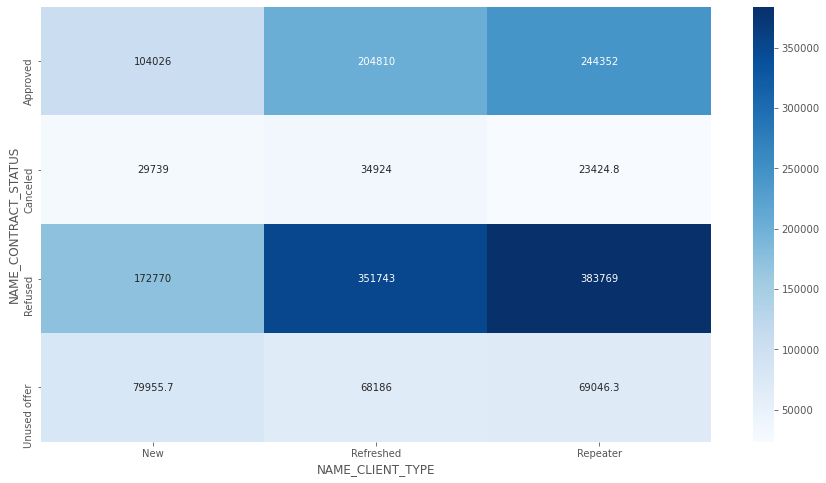

In [140]:
res = pd.pivot_table(data=p_app, index="NAME_CONTRACT_STATUS",columns='NAME_CLIENT_TYPE',values='AMT_CREDIT')
plt.figure(figsize=(15,8))
sns.heatmap(res, annot=True,cmap='Blues', fmt="g")
plt.show()

**Observations :**
    
1) Previously Refused 'Refreshed' and 'Repeater' client has high Credit amount

2) Unused offer CREDIT AMOUNT is low. This may be the reason for customer not using

<h2 style = "color : Blue">  Merging  Current Application and Previous Application Data sets</h2>

In [141]:
#Merge the previous application with the current application data file
merged_df= pd.merge(app, p_app, how='left', on='SK_ID_CURR')
merged_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_x,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_EMPLOYED,DAYS_REGISTRATION,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,ORGANIZATION_TYPE,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AGE_GROUP,SOCIAL_CIRCLE_30_DAYS_DEF_PERC,SOCIAL_CIRCLE_60_DAYS_DEF_PERC,INCOME_GROUP,CREDIT_INCOME_RATIO,SK_ID_PREV,NAME_CONTRACT_TYPE_y,AMT_APPLICATION,AMT_CREDIT_y,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,NAME_YIELD_GROUP,PRODUCT_COMBINATION
0,100002,1,Cash loans,Male,N,Y,0,202500.0,406597.5,24700.5,351000.0,Working,Secondary / secondary special,Single / not married,House / apartment,637,3648.0,0,Laborers,1.0,2,2,Business Entity Type 3,0.0,0.0,0.0,"(20, 25]",1.0,1.0,High,2.0,1038818.0,Consumer loans,179055.0,179055.0,NaN,Approved,-606.0,NaN,NaN,New,Vehicles,POS,NaN,Stone,500.0,Auto technology,low_normal,POS other with interest
1,100003,0,Cash loans,Female,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,1188,1186.0,0,Core staff,2.0,1,1,School,0.0,0.0,0.0,"(40, 45]",0.0,0.0,VeryHigh,5.0,1810518.0,Cash loans,900000.0,1035882.0,NaN,Approved,-746.0,NaN,NaN,Repeater,NaN,Cash,x-sell,Credit and cash offices,-1.0,NaN,low_normal,Cash X-Sell: low
2,100003,0,Cash loans,Female,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,1188,1186.0,0,Core staff,2.0,1,1,School,0.0,0.0,0.0,"(40, 45]",0.0,0.0,VeryHigh,5.0,2636178.0,Consumer loans,337500.0,348637.5,NaN,Approved,-828.0,Cash through the bank,NaN,Refreshed,Furniture,POS,NaN,Stone,1400.0,Furniture,middle,POS industry with interest
3,100003,0,Cash loans,Female,N,N,0,270000.0,1293502.5,35698.5,1129500.0,State servant,Higher education,Married,House / apartment,1188,1186.0,0,Core staff,2.0,1,1,School,0.0,0.0,0.0,"(40, 45]",0.0,0.0,VeryHigh,5.0,2396755.0,Consumer loans,68809.5,68053.5,NaN,Approved,-2341.0,Cash through the bank,NaN,Refreshed,Consumer Electronics,POS,NaN,Country-wide,200.0,Consumer electronics,middle,POS household with interest
4,100004,0,Revolving loans,Male,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Working,Secondary / secondary special,Single / not married,House / apartment,225,4260.0,0,Laborers,1.0,2,2,Government,0.0,0.0,0.0,"(50, 55]",NaN,NaN,VeryLow,2.0,1564014.0,Consumer loans,24282.0,20106.0,NaN,Approved,-815.0,Cash through the bank,NaN,New,Mobile,POS,NaN,Regional / Local,30.0,Connectivity,middle,POS mobile without interest


In [142]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1430006 entries, 0 to 1430005
Data columns (total 49 columns):
 #   Column                          Non-Null Count    Dtype   
---  ------                          --------------    -----   
 0   SK_ID_CURR                      1430006 non-null  int64   
 1   TARGET                          1430006 non-null  int64   
 2   NAME_CONTRACT_TYPE_x            1430006 non-null  object  
 3   CODE_GENDER                     1430006 non-null  object  
 4   FLAG_OWN_CAR                    1430006 non-null  object  
 5   FLAG_OWN_REALTY                 1430006 non-null  object  
 6   CNT_CHILDREN                    1430006 non-null  int64   
 7   AMT_INCOME_TOTAL                1430006 non-null  float64 
 8   AMT_CREDIT_x                    1430006 non-null  float64 
 9   AMT_ANNUITY                     1430006 non-null  float64 
 10  AMT_GOODS_PRICE                 1428789 non-null  float64 
 11  NAME_INCOME_TYPE                1430006 non-null  

<h2 style = "color : Orange">  Analysis on merged data frame</h2>

In [143]:
# Plotting Name contract status to check % of default, ie Target 0 and 1

contract = merged_df['NAME_CONTRACT_STATUS'].unique()
contract

array(['Approved', 'Canceled', 'Refused', nan, 'Unused offer'],
      dtype=object)

Target 0 and 1 for :  Approved
0    0.924112
1    0.075888
Name: TARGET, dtype: float64


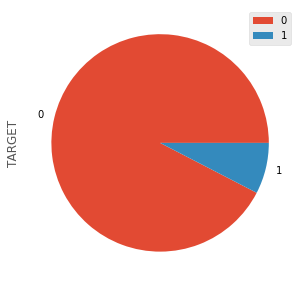

Target 0 and 1 for :  Canceled
0    0.908252
1    0.091748
Name: TARGET, dtype: float64


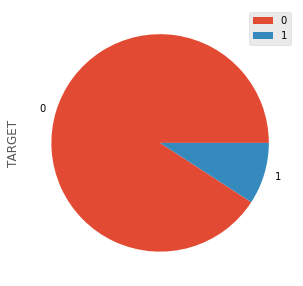

Target 0 and 1 for :  Refused
0    0.880045
1    0.119955
Name: TARGET, dtype: float64


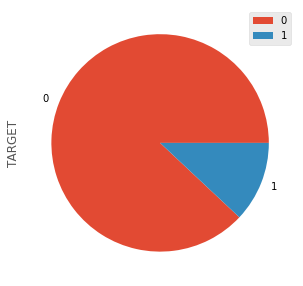

No handles with labels found to put in legend.


Target 0 and 1 for :  nan
Series([], Name: TARGET, dtype: float64)


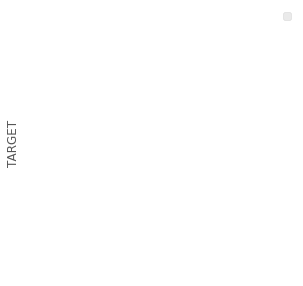

Target 0 and 1 for :  Unused offer
0    0.917472
1    0.082528
Name: TARGET, dtype: float64


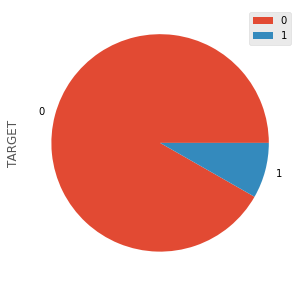

In [144]:
for i in contract:
    print("Target 0 and 1 for : ",i)
    plt.figure(figsize=[8,5])
    print(merged_df[(merged_df['NAME_CONTRACT_STATUS']==i)].TARGET.value_counts(normalize=True))
    merged_df[(merged_df['NAME_CONTRACT_STATUS']==i)].TARGET.value_counts().plot.pie(normalize=True)
    plt.legend()
    plt.show()
    

**Observations :**
    
1) In current loans, 7.5% previously approved clients are defaulters.

2) In current loans, 9.1% previously canceled clients are defaulters.

3) In current loans, 11.9% previously refused clients are defaulters.

4) In current loans, 8.2% previously Unused offer clients are defaulters.



In [145]:
# Number of Defaults in approved cases

approvedDefault = merged_df[(merged_df['NAME_CONTRACT_STATUS']=="Approved") & (merged_df['TARGET']==1)]
approvedDefault.shape

(67238, 49)

#### Analysis based on Previously Approved and Currently Defaulted clients

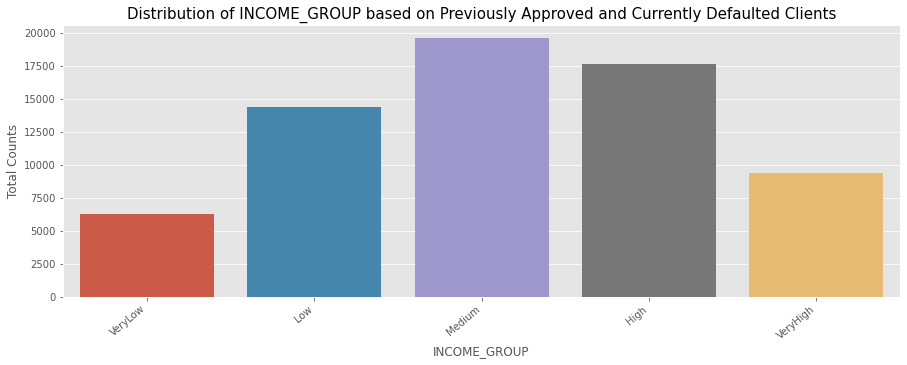

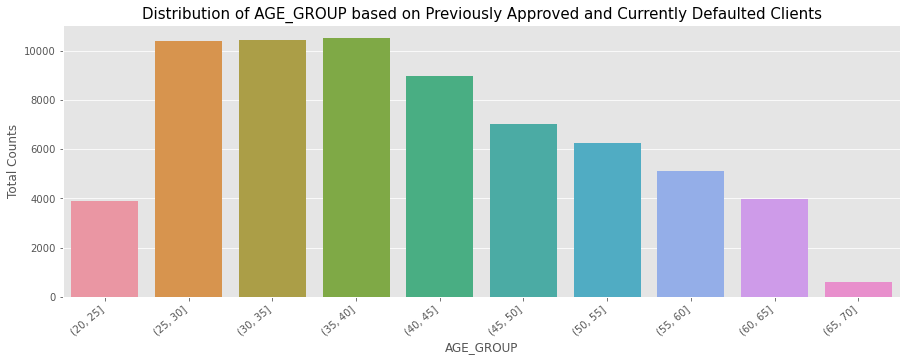

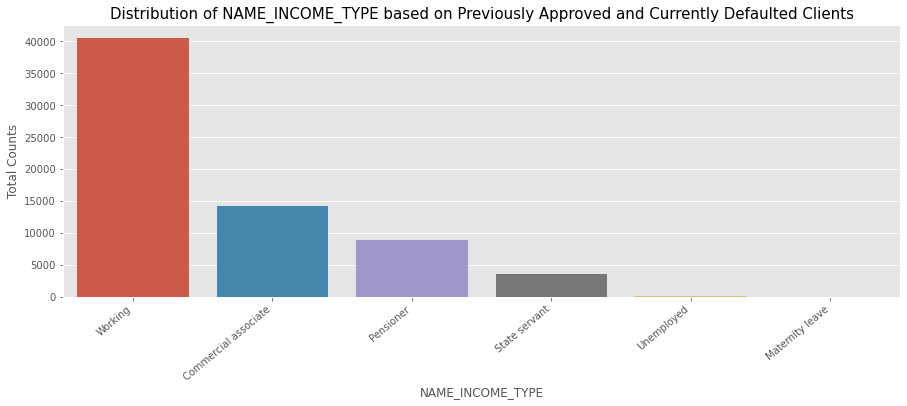

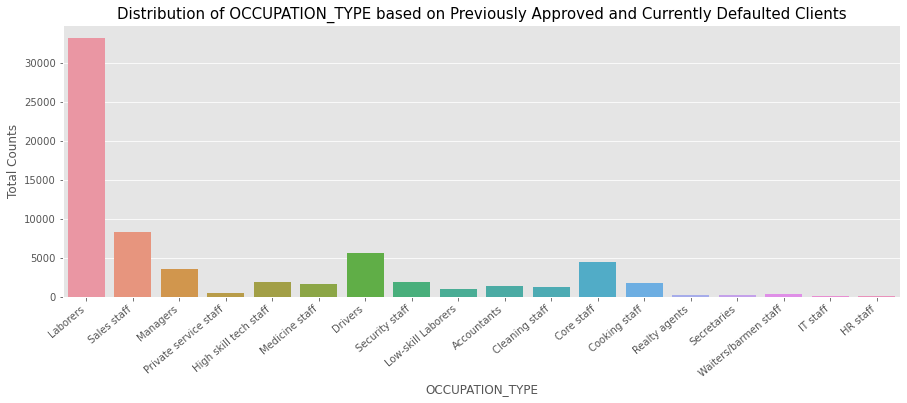

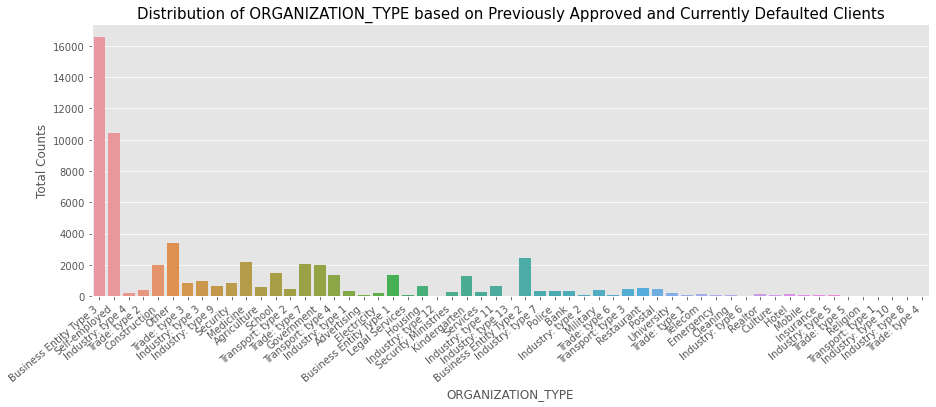

In [146]:
cols=['INCOME_GROUP','AGE_GROUP','NAME_INCOME_TYPE','OCCUPATION_TYPE',"ORGANIZATION_TYPE" ]

for i in cols:
    plt.style.use('ggplot')
    sns.despine
    fig,ax = plt.subplots(1,1,figsize=(15,5))
    
    sns.countplot(approvedDefault[i],ax = ax,)
    ax.set_ylabel('Total Counts')
    plt.title(f"Distribution of {i} based on Previously Approved and Currently Defaulted Clients", fontsize=15)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    
    plt.show()

**Observations :**
    
Previously Approved And Currently Defaulted Clients belong to

1) INCOME_GROUP - 'Medium'

2) AGE_GROUP - Age ranging from 20 to 40

3) NAME_INCOME_TYPE - 'Working'

4) OCCUPATION_TYPE - 'Laborers', 'Sales staff', 'Drivers'

5) ORGANIZATION_TYPE - 'Business Entity type'

#### NAME_CONTRACT_STATUS  -  NAME_INCOME_TYPE

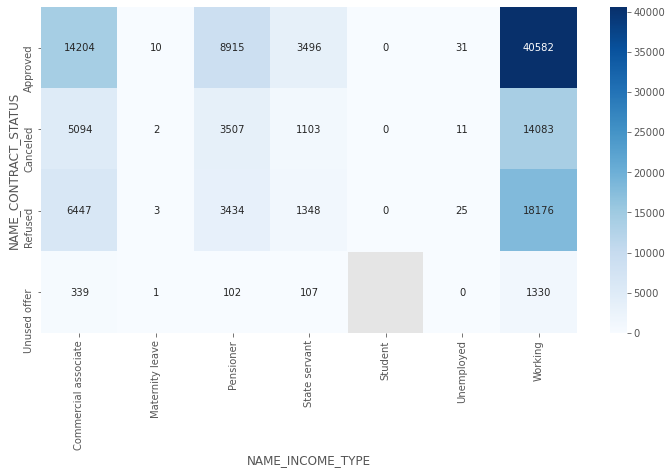

In [147]:
#Checking "NAME_CONTRACT_STATUS", "NAME_INCOME_TYPE",aggregating on Target

res = pd.pivot_table(data = merged_df,index="NAME_CONTRACT_STATUS",columns="NAME_INCOME_TYPE",values='TARGET', aggfunc="sum")
plt.figure(figsize=(12,6))
sns.heatmap(res, annot=True,cmap='Blues', fmt="g")
plt.show()


**Observations :**
    
1) Here higher value indicate correlation to default

2) Working and previously approved clients are the ones defaulted more

3) Here previoulsy Refused, canceled, unused offer also has defaulters but comparatavily low to previously approved

4) Sholud be careful about the clients who are previously approved

#### NAME_CONTRACT_STATUS  -  AGE_GROUP

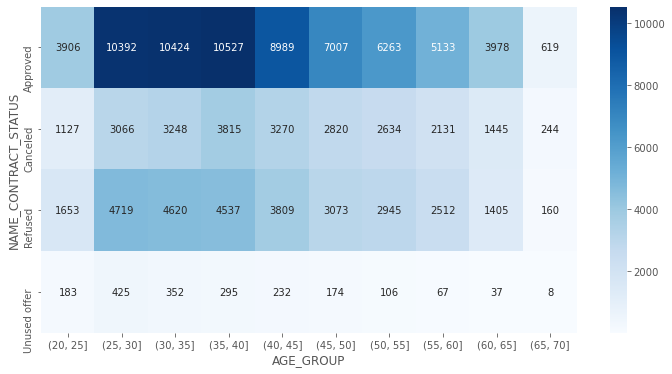

In [148]:
#Checking "NAME_CONTRACT_STATUS", "AGE_GROUP",aggregating on Target

res = pd.pivot_table(data = merged_df,index="NAME_CONTRACT_STATUS",columns="AGE_GROUP",values='TARGET', aggfunc="sum")
plt.figure(figsize = (12,6))
sns.heatmap(res, annot = True,cmap = 'Blues', fmt = "g")
plt.show()

**Observations :**
    
1) Here higher value indicate correlation to default

2) Previously approved category of people have more defaulters, in which age ranging from 25 to 40 have more defaulters

3) previously Refused, canceled, Unused offer also have defaulted in current data, but less compare to Previoulsy approved.

#### NAME_CONTRACT_STATUS  -  NAME_INCOME_TYPE

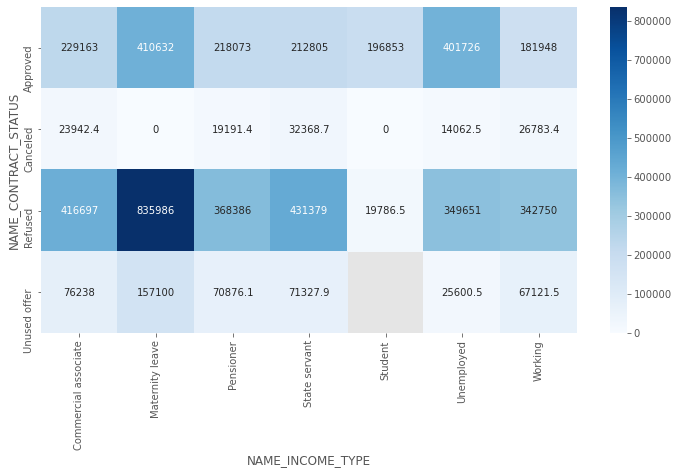

In [149]:
#Checking "NAME_CONTRACT_STATUS", "NAME_INCOME_TYPE",aggregating on AMT_CREDIT

res = pd.pivot_table(data = merged_df,index="NAME_CONTRACT_STATUS",columns="NAME_INCOME_TYPE",values='AMT_CREDIT_y')
plt.figure(figsize=(12,6))
sns.heatmap(res, annot=True,cmap = 'Blues', fmt="g")
plt.show()

**Observations :**
    
1) High credit amount is allowed to previously refused and Maternity leave income type

2) Credit amount is low for previously canceled and unused offers

<h1 style = "color : Red"> Case Study Insights </h1>



**Driving factors to Default**

    - Income Group : Medium
    - Age Group : Age in range 25 to 40
    - Gender : Males are tend to be defaulters
    - Occupation : Laborers, Sales staff, Drivers
    - Contract type : Revolving loans are more likely to become a defaulter
    - Family Status : Married and widow
    - Region Rating : People living in better areas (rating 3)
    - Income and Education Status
        - People with higher education who have lesser income are tend to be defaulter
        - Secondary / secondary special with low income are tend to be a defaulter.
    - Contract type : Student ,pensioner and Businessman 
    - Working and previously approved clients are the ones defaulted more
    - clients who doesn't have a car are tend to be a defaulter
    - Family with less number of members and less number of children are tend to be defaulter


<h1 style = "color : Orange"> Conclusion</h1>


**Bank should be careful while approving loans to previously approved clients especially the one belongs to "Working" category**

**Should focus more on contract type Student ,pensioner and Businessman**

**If the clients are living with parents then give preference to them since they are less tend to be a defaulter**

**In unused offers the credit amout is low, this may be the reason that the client refused to accept the offer.**

**Banks should focus more on Higher educated married people with higher Income**

**Most of the clients of banks are repeated so bank should focus to get new customers**

 